<a href="https://colab.research.google.com/github/NguyenGiaKhanh141/Store_Sales/blob/main/DSP305x_Final_Project_Option_1_khanhngFX08122_funix_edu_vn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import gc
import math

import os
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
from plotly.subplots import make_subplots
from math import sqrt
import re

In [ ]:
!pip install --upgrade pip

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.1/2.1 MB 24.8 MB/s eta 0:00:00
  Attempting uninstall: pip
    Found existing installation: pip 23.1.2
    Uninstalling pip-23.1.2:
      Successfully uninstalled pip-23.1.2


In [ ]:
!pip install pandas==1.3.5

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 11.5/11.5 MB 83.0 MB/s eta 0:00:00
  Attempting uninstall: pandas
    Found existing installation: pandas 2.0.3
    Uninstalling pandas-2.0.3:
      Successfully uninstalled pandas-2.0.3
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
bigframes 1.0.0 requires pandas>=1.5.0, but you have pandas 1.3.5 which is incompatible.
google-colab 1.0.0 requires pandas==2.0.3, but you have pandas 1.3.5 which is incompatible.
plotnine 0.12.4 requires pandas>=1.5.0, but you have pandas 1.3.5 which is incompatible.
xarray 2023.7.0 requires pandas>=1.4, but you have pandas 1.3.5 which is incompatible.


In [ ]:
import pandas as pd
print(pd.__version__)

1.3.5


In [ ]:
# Upgrade scikit-learn to the latest version.
#!pip install --upgrade scikit-learn
from sklearn.metrics import root_mean_squared_log_error

In [ ]:
!pip install optuna
import optuna
from optuna.visualization import plot_contour
from optuna.visualization import plot_edf
from optuna.visualization import plot_intermediate_values
from optuna.visualization import plot_optimization_history
from optuna.visualization import plot_parallel_coordinate
from optuna.visualization import plot_param_importances
from optuna.visualization import plot_slice

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 379.9/379.9 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.4/233.4 kB 13.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 78.7/78.7 kB 11.5 MB/s eta 0:00:00


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path = '/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/'
os.listdir(path)

['sample_submission.csv',
 'test.csv',
 'stores.csv',
 'holidays_events.csv',
 'oil.csv',
 'train.csv',
 'transactions.csv',
 'submission.csv']

In [ ]:
for dirname, _, filenames in os.walk('/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/sample_submission.csv
/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/test.csv
/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/stores.csv
/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/holidays_events.csv
/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/oil.csv
/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/train.csv
/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/transactions.csv
/content/drive/MyDrive/Coding_DS/Project Store sales/Dataset/submission.csv


In [ ]:
data_oil = pd.read_csv(path+'oil.csv')
train_data = pd.read_csv(path+'train.csv', index_col=0)
test_data = pd.read_csv(path+'test.csv', index_col=0)
samp_subm = pd.read_csv(path+'sample_submission.csv')
data_holi = pd.read_csv(path+'holidays_events.csv')
data_store =  pd.read_csv(path+'stores.csv')
data_trans = pd.read_csv(path+'transactions.csv')

# 1.OVERVIEW DATASET

In [ ]:
print(f'Number of data_oil samples: {data_oil.shape}')
print(f'Number of train_data samples: {train_data.shape}')
print(f'Number of test_data samples: {test_data.shape}')
print(f'Number of samp_subm samples: {samp_subm.shape}')
print(f'Number of data_holi samples: {data_holi.shape}')
print(f'Number of data_store samples: {data_store.shape}')
print(f'Number of data_trans samples: {data_trans.shape}')

Number of data_oil samples: (1218, 2)
Number of train_data samples: (3000888, 5)
Number of test_data samples: (28512, 4)
Number of samp_subm samples: (28512, 2)
Number of data_holi samples: (350, 6)
Number of data_store samples: (54, 5)
Number of data_trans samples: (83488, 3)


In [ ]:
print(train_data.info())
print(train_data.columns)
print("Check null:")
print(train_data.isnull().sum())
train_data.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 3000888 entries, 0 to 3000887
Data columns (total 5 columns):
 #   Column       Dtype  
---  ------       -----  
 0   date         object 
 1   store_nbr    int64  
 2   family       object 
 3   sales        float64
 4   onpromotion  int64  
dtypes: float64(1), int64(2), object(2)
memory usage: 137.4+ MB
None
Index(['date', 'store_nbr', 'family', 'sales', 'onpromotion'], dtype='object')
Check null:
date           0
store_nbr      0
family         0
sales          0
onpromotion    0
dtype: int64


,date,store_nbr,family,sales,onpromotion
id,,,,,
0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,2013-01-01,1,BABY CARE,0.0,0
2,2013-01-01,1,BEAUTY,0.0,0
3,2013-01-01,1,BEVERAGES,0.0,0
4,2013-01-01,1,BOOKS,0.0,0


In [ ]:
# Convert the 'Date' column to datetime format
check_date=train_data.copy()
check_date['date'] = pd.to_datetime(check_date['date'])

# Generate a sequence of dates starting from the first date
date_range = pd.date_range(start=check_date['date'].min(), end=check_date['date'].max())

# Check for missing dates
missing_dates = date_range.difference(check_date['date'])

# Display the missing dates
print(missing_dates)

DatetimeIndex(['2013-12-25', '2014-12-25', '2015-12-25', '2016-12-25'], dtype='datetime64[ns]', freq=None)


In [ ]:
print(data_holi.info())
print(data_holi.columns)
print("Check null:")
print(data_holi.isnull().sum())
data_holi.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 350 entries, 0 to 349
Data columns (total 6 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date         350 non-null    object
 1   type         350 non-null    object
 2   locale       350 non-null    object
 3   locale_name  350 non-null    object
 4   description  350 non-null    object
 5   transferred  350 non-null    bool  
dtypes: bool(1), object(5)
memory usage: 14.1+ KB
None
Index(['date', 'type', 'locale', 'locale_name', 'description', 'transferred'], dtype='object')
Check null:
date           0
type           0
locale         0
locale_name    0
description    0
transferred    0
dtype: int64


,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [ ]:
print(data_store.info())
print(data_store.columns)
print("Check null:")
print(data_store.isnull().sum())
data_store.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 54 entries, 0 to 53
Data columns (total 5 columns):
 #   Column     Non-Null Count  Dtype 
---  ------     --------------  ----- 
 0   store_nbr  54 non-null     int64 
 1   city       54 non-null     object
 2   state      54 non-null     object
 3   type       54 non-null     object
 4   cluster    54 non-null     int64 
dtypes: int64(2), object(3)
memory usage: 2.2+ KB
None
Index(['store_nbr', 'city', 'state', 'type', 'cluster'], dtype='object')
Check null:
store_nbr    0
city         0
state        0
type         0
cluster      0
dtype: int64


,store_nbr,city,state,type,cluster
0,1,Quito,Pichincha,D,13
1,2,Quito,Pichincha,D,13
2,3,Quito,Pichincha,D,8
3,4,Quito,Pichincha,D,9
4,5,Santo Domingo,Santo Domingo de los Tsachilas,D,4


In [ ]:
print(data_trans.info())
print(data_trans.columns)
print("Check null:")
print(data_trans.isnull().sum())
data_trans.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 83488 entries, 0 to 83487
Data columns (total 3 columns):
 #   Column        Non-Null Count  Dtype 
---  ------        --------------  ----- 
 0   date          83488 non-null  object
 1   store_nbr     83488 non-null  int64 
 2   transactions  83488 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 1.9+ MB
None
Index(['date', 'store_nbr', 'transactions'], dtype='object')
Check null:
date            0
store_nbr       0
transactions    0
dtype: int64


,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922


In [ ]:
print(data_oil.info())
print(data_oil.columns)
print("Check null:")
print(data_oil.isnull().sum())
data_oil.head()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1218 entries, 0 to 1217
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   date        1218 non-null   object 
 1   dcoilwtico  1175 non-null   float64
dtypes: float64(1), object(1)
memory usage: 19.2+ KB
None
Index(['date', 'dcoilwtico'], dtype='object')
Check null:
date           0
dcoilwtico    43
dtype: int64


,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [ ]:
print(test_data.info())
print(test_data.columns)
print("Check null:")
print(test_data.isnull().sum())
test_data.head()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 28512 entries, 3000888 to 3029399
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype 
---  ------       --------------  ----- 
 0   date         28512 non-null  object
 1   store_nbr    28512 non-null  int64 
 2   family       28512 non-null  object
 3   onpromotion  28512 non-null  int64 
dtypes: int64(2), object(2)
memory usage: 1.1+ MB
None
Index(['date', 'store_nbr', 'family', 'onpromotion'], dtype='object')
Check null:
date           0
store_nbr      0
family         0
onpromotion    0
dtype: int64


,date,store_nbr,family,onpromotion
id,,,,
3000888,2017-08-16,1,AUTOMOTIVE,0
3000889,2017-08-16,1,BABY CARE,0
3000890,2017-08-16,1,BEAUTY,2
3000891,2017-08-16,1,BEVERAGES,20
3000892,2017-08-16,1,BOOKS,0


In [ ]:
unique_store = test_data['store_nbr'].nunique()
print(f'Number of unique store: {unique_store}')

Number of unique store: 54


In [ ]:
unique_family = test_data['family'].nunique()
print(f'Number of unique family: {unique_family}')

Number of unique family: 33


In [ ]:
valid_start_date = '2017-08-01'
valid_end_date = '2017-08-15'

X_valid = train_data[(train_data['date'] >= valid_start_date) & (train_data['date'] <= valid_end_date)]

In [ ]:
unique_store = X_valid['store_nbr'].nunique()
print(f'Number of unique store: {unique_store}')
unique_family = X_valid['family'].nunique()
print(f'Number of unique family: {unique_family}')

Number of unique store: 54
Number of unique family: 33


# 2.ANALYSIS OF TRAIN DATASET

In [ ]:
train = pd.merge(train_data, data_store, how='left', on='store_nbr')
train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type,cluster
0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13
1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13
2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13
3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13
4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13


##**2.2 CHART TIME SERIES AVG SALES ON EACH DAY**

In [ ]:
train_aux = train[['date', 'sales', 'onpromotion']].groupby('date').mean()
train_aux = train_aux.reset_index()
print(train_aux.head())
fig = go.Figure(data=go.Scatter(x=train_aux['date'],
                                y=train_aux['sales'],
                                marker_color='red', text="sales"))
fig.update_layout({"title": f'Avg Sales by date for all stores and products',
                   "xaxis": {"title":"Date"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": False})
fig.show()

         date       sales  onpromotion
0  2013-01-01    1.409438          0.0
1  2013-01-02  278.390807          0.0
2  2013-01-03  202.840197          0.0
3  2013-01-04  198.911154          0.0
4  2013-01-05  267.873244          0.0


* Increasing trend of the sales.

In the last two years (since July 2015) the trend has been stable (almost stationary TS).

By zooming in one can realize that there is a seasonality every 7 days, same pattern (during the weekends higher sales). The peak of the weekly sesoanlity is on Sundays/Saturdays.

The 1st of Jan of every year the supermarkets are not open (sales=0).

* Xu hướng tăng doanh số bán hàng.

Trong hai năm qua (kể từ tháng 7 năm 2015) xu hướng ổn định (TS gần như đứng yên).

Bằng cách phóng to, người ta có thể nhận ra rằng cứ 7 ngày lại có tính thời vụ, cùng một kiểu mẫu (doanh số bán hàng cao hơn vào cuối tuần). Đỉnh cao của sesoanlity hàng tuần là vào Chủ Nhật/Thứ Bảy.

Ngày 1 tháng 1 hàng năm các siêu thị không mở cửa (doanh số = 0).
Ngoài ra vì ngày 25 tháng 12 cũng là ngày không mở cửa nhưng không ghi nhận data nào cho nên hàng năm có 2 ngày là 1/1 và 25/12 là cửa hàng không có sale

## 2.3 ON PROMOTION VS AVG SALES

In [ ]:
fig = px.scatter(train_aux[train_aux['onpromotion'] > 0], x="onpromotion", y="sales", color='sales',
                           color_continuous_scale="earth",
                 size='sales', log_x=True, size_max=30)

fig.update_layout({"title": f'Correlation between OnPromotion and Sales (total avg sales and promotion on each day)',
                   "xaxis": {"title":"On Promotion"},
                   "yaxis": {"title":"Sales"},
                   "showlegend": False})
fig.show()

* There is a positive correlation between onpromotion and sales units sold. Thus, when more items of the supermarkets are on promotion, it's more likely to sell them. It means that the price elasticity of some items is high and the demand of some items in the sumermarkets is highly correlated to cjanges in price of the itrems.

What family products have higher elasticity? I guess that the data scientist at Favorita supermarkets have done that analysis. They have determined what product are more sensitve to changes in price by maximixing the revenue.

* Có mối tương quan dương giữa khuyến mãi và số lượng hàng bán được. Như vậy, khi siêu thị có nhiều mặt hàng khuyến mãi thì khả năng bán được hàng sẽ cao hơn. Điều đó có nghĩa là độ co giãn theo giá của một số mặt hàng cao và nhu cầu của một số mặt hàng trong thị trường mùa hè có mối tương quan chặt chẽ với sự thay đổi về giá của mặt hàng đó.

Sản phẩm gia đình nào có độ co giãn của cầu theo giá cao hơn? Tôi đoán rằng nhà khoa học dữ liệu tại siêu thị Favorita đã thực hiện phân tích đó. Họ đã xác định sản phẩm nào nhạy cảm hơn với những thay đổi về giá bằng cách tối đa hóa doanh thu.

## 2.4 AVG SALES/ON PROMOTION BY YEAR, MONTH AND DAY OF WEEK CHARTS

In [ ]:
#create new features
train['year'] = pd.to_datetime(train['date']).dt.year
train['month'] = pd.to_datetime(train['date']).dt.strftime("%B")
train['day_of_week'] = pd.to_datetime(train['date']).dt.day_name()
train.head()

,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,year,month,day_of_week
0,2013-01-01,1,AUTOMOTIVE,0.0,0,Quito,Pichincha,D,13,2013,January,Tuesday
1,2013-01-01,1,BABY CARE,0.0,0,Quito,Pichincha,D,13,2013,January,Tuesday
2,2013-01-01,1,BEAUTY,0.0,0,Quito,Pichincha,D,13,2013,January,Tuesday
3,2013-01-01,1,BEVERAGES,0.0,0,Quito,Pichincha,D,13,2013,January,Tuesday
4,2013-01-01,1,BOOKS,0.0,0,Quito,Pichincha,D,13,2013,January,Tuesday


In [ ]:
df_year_s = train.groupby('year').mean()[['sales']]
df_year_s = df_year_s.reset_index()
df_year_s['color'] =['rgb(210, 251, 212)', 'rgb(165, 219,194)', 'rgb(123,188, 176)', 'rgb(85, 156,158)', 'rgb(58,124, 137)']

df_month_s = train.groupby('month').mean()[['sales']]
df_month_s = df_month_s.sort_values('sales', ascending=True)
df_month_s['color'] = ['#bfbf40','#abab39','#989833','#85852c','#727226','#5f5f20','#5f5f20','#4c4c19','#393913','#26260c','#131306','#000000']
new_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
df_month_s = df_month_s.reindex(new_order, axis=0)
df_month_s = df_month_s.reset_index()


df_day_of_week_s = train.groupby('day_of_week').mean()[['sales']]
df_day_of_week_s = df_day_of_week_s.sort_values('sales', ascending=False)
df_day_of_week_s['color'] = ['rgb(255, 0, 0)','rgb(255, 36, 36)','rgb(255, 71, 71)','rgb(255, 107, 107)','rgb(255, 143, 143)','rgb(255, 179, 179)','rgb(255, 214, 214)']
new_order_week = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
df_day_of_week_s = df_day_of_week_s.reindex(new_order_week, axis=0)
df_day_of_week_s = df_day_of_week_s.reset_index()

<ipython-input-26-53544eb41b0e>:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

<ipython-input-26-53544eb41b0e>:5: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

<ipython-input-26-53544eb41b0e>:13: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [ ]:
df_year = train.groupby('year').mean()[['onpromotion']]
df_year = df_year.reset_index()
df_year['color'] =['rgb(210, 251, 212)', 'rgb(165, 219,194)', 'rgb(123,188, 176)', 'rgb(85, 156,158)', 'rgb(58,124, 137)']



df_month = train.groupby('month').mean()[['onpromotion']]
df_month = df_month.sort_values('onpromotion', ascending=True)
df_month['color'] = ['#bfbf40','#abab39','#989833','#85852c','#727226','#5f5f20','#5f5f20','#4c4c19','#393913','#26260c','#131306','#000000']
new_order = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December']
df_month = df_month.reindex(new_order, axis=0)
df_month = df_month.reset_index()


df_day_of_week = train.groupby('day_of_week').mean()[['onpromotion']]
df_day_of_week = df_day_of_week.sort_values('onpromotion', ascending=False)
df_day_of_week['color'] = ['rgb(255, 0, 0)','rgb(255, 36, 36)','rgb(255, 71, 71)','rgb(255, 107, 107)','rgb(255, 143, 143)','rgb(255, 179, 179)','rgb(255, 214, 214)']
new_order_week = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
df_day_of_week = df_day_of_week.reindex(new_order_week, axis=0)
df_day_of_week = df_day_of_week.reset_index()

<ipython-input-27-4fa0c2c390d3>:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

<ipython-input-27-4fa0c2c390d3>:7: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.

<ipython-input-27-4fa0c2c390d3>:15: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [ ]:
fig = make_subplots(rows=3, cols=2,
                    subplot_titles=("Avg Sales by Year", "Avg On Promotion by Year", "Avg Sales by Month",
                                   "Avg On Promotion by MOnth", "Avg Sales by Day of Week", "Avg On Promotion by Day of Week"))
#SALES
fig.append_trace(go.Bar(x=df_year_s['year'], y=df_year_s['sales'], marker = {'color': list(df_year_s['color'])}),
                row=1, col=1)


fig.append_trace(go.Bar(x=df_month_s['month'], y=df_month_s['sales'], marker = {'color': list(df_month_s['color'])}),
                 row=2, col=1)

fig.append_trace(go.Bar(x=df_day_of_week_s['day_of_week'], y=df_day_of_week_s['sales'], marker = {'color': list(df_day_of_week_s['color'])}), row=3, col=1)

##ONPROMOTION
fig.append_trace(go.Bar(x=df_year['year'], y=df_year['onpromotion'], marker = {'color': list(df_year['color'])}),
                row=1, col=2)


fig.append_trace(go.Bar(x=df_month['month'], y=df_month['onpromotion'], marker = {'color': list(df_month['color'])}),
                 row=2, col=2)

fig.append_trace(go.Bar(x=df_day_of_week['day_of_week'], y=df_day_of_week['onpromotion'],
                        marker = {'color': list(df_day_of_week['color'])}), row=3, col=2)
#styling
#fig.update_yaxes(showgrid=False, ticksuffix=' ', categoryorder='total ascending', row=1, col=1)
#fig.update_xaxes(visible=False, row=1, col=1)

fig.update_layout(height=1000, width=1400, title_text="AVERAGE SALES & ONPROMOTION ANALYSIS",
                  title_font=dict(size=30, color='#8a8d93'), showlegend=False)
fig.show()

* There's an increasing trend in sales every year. It probably has to do with the decrease in oil prices (as it gives more purchasing power to consumers) or with growing econonmic conditions of Ecuador.
December is the month with the highst average units sold (Christmas is in December).
During the weekends customers purchase more compared to week days.

There has been an exponential increase in teh promotions trhoughout the years. No promotions in 2013.

Highest promotions are during summer (June, July) and December (Christmas).
Altough the highest sale son Sunday, the highest promotions are on Wednesdays and Fridays.

* Có xu hướng tăng doanh số bán hàng mỗi năm. Nó có thể liên quan đến việc giá dầu giảm (vì nó mang lại nhiều sức mua hơn cho người tiêu dùng) hoặc với điều kiện kinh tế ngày càng tăng của Ecuador.
Tháng 12 là tháng có số lượng căn hộ bán được trung bình cao nhất (Giáng sinh vào tháng 12).
Vào cuối tuần, khách hàng mua sắm nhiều hơn so với các ngày trong tuần.

Đã có sự gia tăng theo cấp số nhân trong các chương trình khuyến mãi trong suốt những năm qua. Không có khuyến mại trong năm 2013

Khuyến mãi cao nhất là vào mùa hè (tháng 6, tháng 7) và tháng 12 (Giáng Sinh).
Tuy là ngày chủ nhật có doanh số bán hàng cao nhất nhưng mức khuyến mãi cao nhất lại là vào thứ Tư và thứ Sáu.

## 2.5 Let's check items that are most sold and the promotion to see which items influence the most for the total sales.

In [ ]:
print(train_data.family.unique())
print(len(train_data.family.unique()))
train_data['family'] = train_data['family'].astype('category')
train_data['family_category'] = train_data['family'].cat.codes

family_category = dict( zip( train_data['family'].cat.codes, train_data['family'] ) )
family_category

['AUTOMOTIVE' 'BABY CARE' 'BEAUTY' 'BEVERAGES' 'BOOKS' 'BREAD/BAKERY'
 'CELEBRATION' 'CLEANING' 'DAIRY' 'DELI' 'EGGS' 'FROZEN FOODS' 'GROCERY I'
 'GROCERY II' 'HARDWARE' 'HOME AND KITCHEN I' 'HOME AND KITCHEN II'
 'HOME APPLIANCES' 'HOME CARE' 'LADIESWEAR' 'LAWN AND GARDEN' 'LINGERIE'
 'LIQUOR,WINE,BEER' 'MAGAZINES' 'MEATS' 'PERSONAL CARE' 'PET SUPPLIES'
 'PLAYERS AND ELECTRONICS' 'POULTRY' 'PREPARED FOODS' 'PRODUCE'
 'SCHOOL AND OFFICE SUPPLIES' 'SEAFOOD']
33


{0: 'AUTOMOTIVE',
 1: 'BABY CARE',
 2: 'BEAUTY',
 3: 'BEVERAGES',
 4: 'BOOKS',
 5: 'BREAD/BAKERY',
 6: 'CELEBRATION',
 7: 'CLEANING',
 8: 'DAIRY',
 9: 'DELI',
 10: 'EGGS',
 11: 'FROZEN FOODS',
 12: 'GROCERY I',
 13: 'GROCERY II',
 14: 'HARDWARE',
 15: 'HOME AND KITCHEN I',
 16: 'HOME AND KITCHEN II',
 17: 'HOME APPLIANCES',
 18: 'HOME CARE',
 19: 'LADIESWEAR',
 20: 'LAWN AND GARDEN',
 21: 'LINGERIE',
 22: 'LIQUOR,WINE,BEER',
 23: 'MAGAZINES',
 24: 'MEATS',
 25: 'PERSONAL CARE',
 26: 'PET SUPPLIES',
 27: 'PLAYERS AND ELECTRONICS',
 28: 'POULTRY',
 29: 'PREPARED FOODS',
 30: 'PRODUCE',
 31: 'SCHOOL AND OFFICE SUPPLIES',
 32: 'SEAFOOD'}

Most family sales

<ipython-input-30-0504d5cff6f4>:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



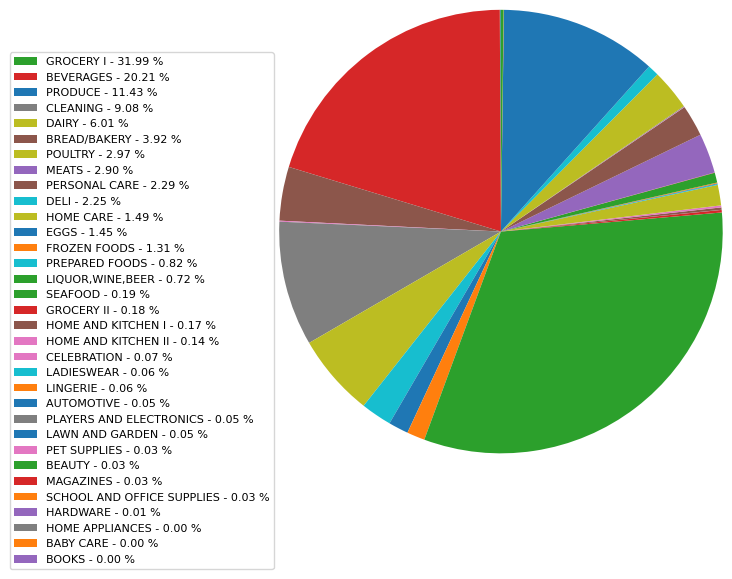

In [ ]:
data_grouped_family_types = train_data.groupby(['family_category']).mean()[['sales', 'onpromotion']]


data_grouped_family_types['%_s'] = 100 * data_grouped_family_types['sales'] / data_grouped_family_types['sales'].sum()
data_grouped_family_types['%_s'] = data_grouped_family_types['%_s'].round(decimals = 3)


percent = 100 * data_grouped_family_types['sales'] / data_grouped_family_types['sales'].sum()
percent = percent.round(decimals = 3)
patches, texts = plt.pie(data_grouped_family_types['%_s'], startangle=90, radius=1.5)


lables_2 = ['{0} - {1:1.2f} %'.format(i,j) for i,j in zip(family_category.values(), percent)]


sort_legend = True
if sort_legend:
    patches, labels, dummy =  zip(*sorted(zip(patches, lables_2, data_grouped_family_types['%_s']),
                                          key=lambda x: x[2],
                                          reverse=True))

plt.legend(patches, labels, loc='best', bbox_to_anchor=(-0.1, 1.),
           fontsize=8)




Most family on promotion

<ipython-input-31-46f4fcdebe5e>:1: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



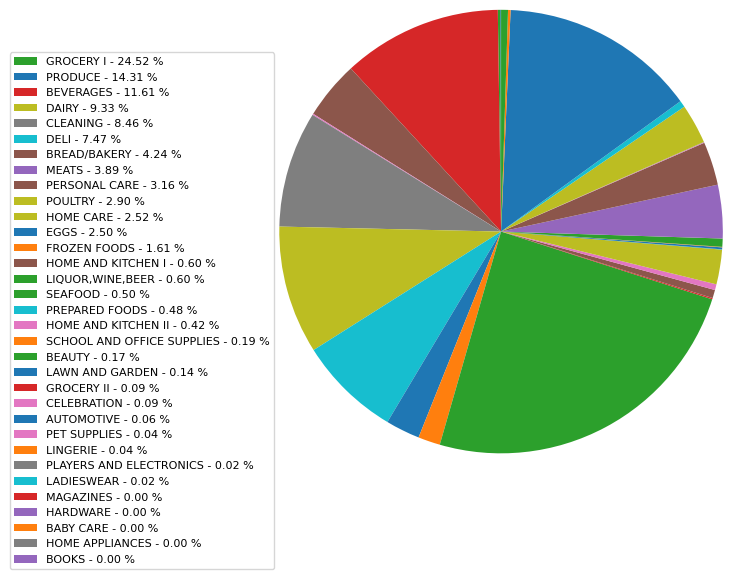

In [ ]:
data_grouped_family_types = train_data.groupby(['family_category']).mean()[['sales', 'onpromotion']]


data_grouped_family_types['%_p'] = 100 * data_grouped_family_types['onpromotion'] / data_grouped_family_types['onpromotion'].sum()
data_grouped_family_types['%_p'] = data_grouped_family_types['%_p'].round(decimals = 3)


percent = 100 * data_grouped_family_types['onpromotion'] / data_grouped_family_types['onpromotion'].sum()
percent = percent.round(decimals = 3)
patches, texts = plt.pie(data_grouped_family_types['%_p'], startangle=90, radius=1.5)


lables_2 = ['{0} - {1:1.2f} %'.format(i,j) for i,j in zip(family_category.values(), percent)]


sort_legend = True
if sort_legend:
    patches, labels, dummy =  zip(*sorted(zip(patches, lables_2, data_grouped_family_types['%_p']),
                                          key=lambda x: x[2],
                                          reverse=True))

plt.legend(patches, labels, loc='best', bbox_to_anchor=(-0.1, 1.),
           fontsize=8)

* The top 5 most sold are Grocery, beverages, cleaning, dairy, and produce. Grocery + beverage account for more than 50% of total sales.

* Top 5 được bán nhiều nhất là Tạp hóa, đồ uống, chất tẩy rửa, sản phẩm từ sữa và nông sản. Hàng tạp hóa + đồ uống chiếm hơn 50% tổng doanh thu. Tạp hóa, nông sản, đồ uống, sản phẩm từ sữa, chất tẩy rửa cũng là những sản phẩm được sale nhiều nhất

# 3.TRANSACTIONS

This feature is highly correlated with sales but first, you are supposed to sum the sales feature to find relationship. Transactions means how many people came to the store or how many invoices created in a day.

Sales gives the total sales for a product family at a particular store at a given date. Fractional values are possible since products can be sold in fractional units (1.5 kg of cheese, for instance, as opposed to 1 bag of chips).

That's why, transactions will be one of the relevant features in the model. In the following sections, we will generate new features by using transactions.

In [ ]:
transactions=data_trans.copy()
transactions.head(10)

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922
5,2013-01-02,5,1903
6,2013-01-02,6,2143
7,2013-01-02,7,1874
8,2013-01-02,8,3250
9,2013-01-02,9,2940


In [ ]:
temp = pd.merge(train_data.groupby(["date", "store_nbr"]).sales.sum().reset_index(), transactions, how = "left")
print("Spearman Correlation between Total Sales and Transactions: {:,.4f}".format(temp.corr("spearman").sales.loc["transactions"]))
px.line(transactions.sort_values(["store_nbr", "date"]), x='date', y='transactions', color='store_nbr',title = "Transactions" )

<ipython-input-33-c14078489a9f>:2: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



Spearman Correlation between Total Sales and Transactions: 0.8175


There is a stable pattern in Transaction. All months are similar except December from 2013 to 2017 by boxplot. In addition, we've just seen same pattern for each store in previous plot. Store sales had always increased at the end of the year.

In [ ]:
transactions["date"] = pd.to_datetime(transactions.date)
a = transactions.copy()
a["year"] = a.date.dt.year
a["month"] = a.date.dt.month
px.box(a, x="year", y="transactions" , color = "month", title = "Transactions")

Let's take a look at transactions by using monthly average sales!

We've just learned a pattern what increases sales. It was the end of the year. We can see that transactions increase in spring and decrease after spring.

In [ ]:
a = transactions.set_index("date").resample("M").transactions.mean().reset_index()
a["year"] = a.date.dt.year
px.line(a, x='date', y='transactions', color='year',title = "Monthly Average Transactions" )

When we look at their relationship, we can see that there is a highly correlation between total sales and transactions also.

In [ ]:
px.scatter(temp, x = "transactions", y = "sales", trendline = "ols", trendline_color_override = "red")

The days of week is very important for shopping. It shows us a great pattern. Stores make more transactions at weekends. Almost, the patterns are same from 2013 to 2017 and Saturday is the most important day for shopping.

In [ ]:
a = transactions.copy()
a["year"] = a.date.dt.year
a["dayofweek"] = a.date.dt.dayofweek+1
a = a.groupby(["year", "dayofweek"]).transactions.mean().reset_index()
px.line(a, x="dayofweek", y="transactions" , color = "year", title = "Transactions")

# 3.HOLIDAYS & EVENTS

Ngày lễ và Sự kiện, với siêu dữ liệu
* LƯU Ý: Đặc biệt chú ý đến cột được chuyển (tranferred). Ngày nghỉ lễ được chuyển chính thức rơi vào ngày dương lịch đó nhưng đã được chính phủ dời sang ngày khác. Một ngày được chuyển giống như một ngày bình thường hơn là một ngày nghỉ lễ. Để tìm ngày thực sự được tổ chức, hãy tìm hàng tương ứng có loại là Chuyển giao. Ví dụ: ngày lễ Independencia de Guayaquil được chuyển từ ngày 10-09-2012 sang ngày 12-10-2012, có nghĩa là ngày lễ này được tổ chức vào ngày 12-10-2012.
* Những ngày thuộc loại Cầu (Bridge) là những ngày bổ sung được thêm vào một kỳ nghỉ (ví dụ: kì nghỉ giáng sinh bị dính vào ngày t7 và cn trong khi ngày này đã được nghỉ sẵn thì sẽ được bù vào những ngày sau vd: t2, t3) chỉ dành cho dịp nghỉ lễ đặc biệt kiểu giáng sinh
* Các ngày lễ bổ sung (Additional) là những ngày được thêm vào một ngày nghỉ theo lịch thông thường, ví dụ như thường xảy ra vào dịp Giáng sinh (làm cho Đêm Giáng sinh trở thành một ngày lễ).
* Event là những sự kiện nhưng không được nghỉ vd: ngày của mẹ,...
* Workday: ngày làm cả thứ 7 và chủ nhật (chưa hiểu lắm)

In [ ]:
# filter holidays for the training dataset window.
holidays_events = data_holi.copy()
holidays_events = holidays_events[(holidays_events['date'] >= "2013-01-01") & (holidays_events['date'] <= "2017-08-15")]

In [ ]:
holidays_events


,date,type,locale,locale_name,description,transferred
41,2013-01-01,Holiday,National,Ecuador,Primer dia del ano,False
42,2013-01-05,Work Day,National,Ecuador,Recupero puente Navidad,False
43,2013-01-12,Work Day,National,Ecuador,Recupero puente primer dia del ano,False
44,2013-02-11,Holiday,National,Ecuador,Carnaval,False
45,2013-02-12,Holiday,National,Ecuador,Carnaval,False
...,...,...,...,...,...,...
322,2017-07-25,Additional,Local,Guayaquil,Fundacion de Guayaquil,False
323,2017-08-05,Holiday,Local,Esmeraldas,Fundacion de Esmeraldas,False
324,2017-08-10,Holiday,National,Ecuador,Primer Grito de Independencia,True
325,2017-08-11,Transfer,National,Ecuador,Traslado Primer Grito de Independencia,False


## 3.1 Average sales chart with events


In [ ]:
##Let's look at the sales behavior for the whole data
train_aux = train[['date', 'sales']].groupby('date').mean()
train_aux = train_aux.reset_index()
fig = go.Figure(data=go.Scatter(x=train_aux['date'],
                                y=train_aux['sales'],
                                marker_color='red', text="sales"))
for holiday_date in list(holidays_events['date']):
    fig.add_vline(x=holiday_date, line_width=0.5, line_dash="dash", line_color="green")
#fig.add_vline(x="2013-08-08", line_width=0.5, line_dash="dash", line_color="green", annotation="test")


fig.update_layout({"title": f'Avg Sales by date with Holidays Events',
                   "xaxis": {"title":"Date"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": False})
fig.show()

* The earthquake hit the 16th April 2016. One month onwards from that date we can see a slight increase in sales. After the earthquake there were more days off than usual.

* Trận động đất xảy ra vào ngày 16 tháng 4 năm 2016. Một tháng trở đi kể từ ngày đó, chúng ta có thể thấy doanh số bán hàng tăng nhẹ. Sau trận động đất có nhiều ngày nghỉ hơn bình thường.

## 3.2 Avg sales on Event Dates

In [ ]:
holidays_events["date"]= pd.to_datetime(holidays_events.date)
train_aux["date"]= pd.to_datetime(train_aux.date)
df_plot = pd.merge(holidays_events, train_aux, on='date', how='inner')
df_plot.loc[df_plot['description'].isin(['Black Friday', 'Cyber Monday']), 'type'] = 'black_friday_cyber_monday'

In [ ]:
pd. set_option("display.max_rows", 300)
df_plot

,date,type,locale,locale_name,description,transferred,sales
0,2013-01-01,Holiday,National,Ecuador,Primer dia del ano,False,1.409438
1,2013-01-05,Work Day,National,Ecuador,Recupero puente Navidad,False,267.873244
2,2013-01-12,Work Day,National,Ecuador,Recupero puente primer dia del ano,False,226.295293
3,2013-02-11,Holiday,National,Ecuador,Carnaval,False,156.356672
4,2013-02-12,Holiday,National,Ecuador,Carnaval,False,173.288884
5,2013-03-02,Holiday,Local,Manta,Fundacion de Manta,False,307.439509
6,2013-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False,240.637737
7,2013-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False,176.428152
8,2013-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False,268.472025
9,2013-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False,272.570725


In [ ]:
fig = px.scatter(df_plot, x="date", y="sales", size='sales', color='type')
                 #size='sales', color='sales',
                  #color_continuous_scale="pinkyl")

fig.update_layout({"title": f'Avg Sales on Holiday Events days',
                   "xaxis": {"title":"HOLIDAY EVENT DATE"},
                   "yaxis": {"title":"Avg Sales"},
                   "showlegend": True})

fig.add_annotation(x='2014-07-05',y=500,xref="x",yref="y",text="WORLD CUP",showarrow=True, align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=-30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#ca8ee8",opacity=0.8  )

fig.add_annotation(x='2016-04-20',y=800,xref="x",yref="y",text="EARTHQUAKE",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=-30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#ca8ee8",opacity=0.8)

fig.add_annotation(x='2013-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 13/14",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)


fig.add_annotation(x='2014-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 14/15",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)


fig.add_annotation(x='2015-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 15/16",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)


fig.add_annotation(x='2016-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 16/17",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)



fig.show()

* In the above chart we can also confirm the average increasing trend in sales.

We can clearly see two zones with purple bubbles on consecutive days. If we check the description column, we can clearly see that the purple bubbles of June 2014 correspond to the Football World Cup of Brazil and the purple bubbles of Apr 2016 correspond to days off given by the goverment due to the earthquake. During these two events, the sales went up.

The majority of light green bubles at the end of every year correspond to Christmas celebrations (in December). During this time, people gather togeteher and spend money on quality food and presents for Christmas gatherings with family and friends. We can see that on these days he avg amount spent is he highest for each year.

Black Friday and Ciber Monday (light blue) are also considered. From the chart we can realize that in 2013 and 2014 Black Friday didn't exist in Ecuador. Regarding the avg sales, we can see that they are not as high as expected if we compare them with Christmas sales. It might be because the supermarkets are brick and mortar stores, not e-commerce sites.

* Trong biểu đồ trên, chúng ta cũng có thể xác nhận xu hướng tăng trung bình về doanh số bán hàng.

Chúng ta có thể thấy rõ hai vùng có bong bóng màu tím trong những ngày liên tiếp. Nếu kiểm tra cột mô tả, chúng ta có thể thấy rõ rằng bong bóng màu tím của tháng 6 năm 2014 tương ứng với Giải bóng đá thế giới Brazil và bong bóng màu tím của tháng 4 năm 2016 tương ứng với những ngày nghỉ do chính phủ đưa ra do trận động đất. Trong hai sự kiện này, doanh số bán hàng đã tăng lên.

Phần lớn bong bóng màu xanh nhạt vào cuối năm tương ứng với lễ Giáng sinh (tháng 12). Trong thời gian này, mọi người tụ tập cùng nhau và chi tiền cho những món ăn chất lượng cũng như những món quà cho những buổi họp mặt Giáng sinh cùng gia đình và bạn bè. Chúng ta có thể thấy rằng vào những ngày này, số tiền trung bình anh ấy chi tiêu là cao nhất mỗi năm.

Thứ Sáu Đen và Thứ Hai Ciber (xanh nhạt) cũng được xem xét. Từ biểu đồ, chúng ta có thể nhận ra rằng vào năm 2013 và 2014 Thứ Sáu Đen không tồn tại ở Ecuador. Về doanh số bán hàng trung bình, chúng ta có thể thấy rằng chúng không cao như mong đợi nếu so sánh với doanh số bán hàng trong dịp Giáng sinh. Có thể là do siêu thị là cửa hàng truyền thống chứ không phải trang thương mại điện tử.

## 3.3 Analysis of Salaries

Wages in the public sector are paid every two weeks on the 15 th and on the last day of the month. Let´s study if supermarket sales are affected by this.

In [ ]:
#create a list with the dates of when salaries are paid.
start_date = '2013-01-01'
end_date = '2017-08-15'
salary_dates = pd.date_range(start=start_date , end=end_date , freq='SM').tolist()
salary_dates = [pd.to_datetime(date.to_datetime64()).strftime('%Y-%m-%d') for date in salary_dates]
print(len(salary_dates))
print(salary_dates)

111
['2013-01-15', '2013-01-31', '2013-02-15', '2013-02-28', '2013-03-15', '2013-03-31', '2013-04-15', '2013-04-30', '2013-05-15', '2013-05-31', '2013-06-15', '2013-06-30', '2013-07-15', '2013-07-31', '2013-08-15', '2013-08-31', '2013-09-15', '2013-09-30', '2013-10-15', '2013-10-31', '2013-11-15', '2013-11-30', '2013-12-15', '2013-12-31', '2014-01-15', '2014-01-31', '2014-02-15', '2014-02-28', '2014-03-15', '2014-03-31', '2014-04-15', '2014-04-30', '2014-05-15', '2014-05-31', '2014-06-15', '2014-06-30', '2014-07-15', '2014-07-31', '2014-08-15', '2014-08-31', '2014-09-15', '2014-09-30', '2014-10-15', '2014-10-31', '2014-11-15', '2014-11-30', '2014-12-15', '2014-12-31', '2015-01-15', '2015-01-31', '2015-02-15', '2015-02-28', '2015-03-15', '2015-03-31', '2015-04-15', '2015-04-30', '2015-05-15', '2015-05-31', '2015-06-15', '2015-06-30', '2015-07-15', '2015-07-31', '2015-08-15', '2015-08-31', '2015-09-15', '2015-09-30', '2015-10-15', '2015-10-31', '2015-11-15', '2015-11-30', '2015-12-15', '

In [ ]:
##Let's look at the sales behavior for the whole data
train_aux = train[['date', 'sales']].groupby('date').mean()
train_aux = train_aux.reset_index()
fig = go.Figure(data=go.Scatter(x=train_aux['date'],
                                y=train_aux['sales'],
                                marker_color='brown', text="sales"))
for salary_date in salary_dates:
    fig.add_vline(x=salary_date, line_width=0.5, line_dash="dash", line_color="blue")


fig.update_layout({"title": f'Avg Sales by date with Holidays Events',
                   "xaxis": {"title":"Date"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": False})
fig.show()

##3.4 School time

In [ ]:
# school and office supply sales trend
# This is the family that needs special attention
train_aux=train_data.copy()
train_aux.groupby('date')
school_sales_df = train_aux[train_aux['family'] == 'SCHOOL AND OFFICE SUPPLIES']
daily_school_sales_df = school_sales_df.groupby(['date'])['sales'].mean().reset_index()
fig = go.Figure(data=go.Scatter(x=daily_school_sales_df['date'],
                                y=daily_school_sales_df['sales'],
                                marker_color='red', text="sales"))
fig.show()
# peaks appear in March, April, Augest, and Sept

# 4.STORE ANALYSIS

In [ ]:
## Ranking of units solds by products at each store.
df_family = train[['family', 'sales']].groupby('family').mean().sort_values('sales', ascending=True)
df_family = df_family.reset_index()
df_family['sales'] = df_family['sales']
df_family.head()

,family,sales
0,BOOKS,0.070797
1,BABY CARE,0.110528
2,HOME APPLIANCES,0.457476
3,HARDWARE,1.137833
4,MAGAZINES,2.929082


## 4.2 Avg Sales vs Store Number colored by Store Type

In [ ]:
## Ranking of units solds by store, taking into account all products.
df_store = train[['store_nbr', 'sales']].groupby('store_nbr').mean().sort_values('sales', ascending=False)
df_store = df_store.reset_index()
#df_store['store_nbr'] = 'store_' + df_store['store_nbr'].astype(str)
df_store['sales'] = df_store['sales']
df_store = pd.merge(df_store, data_store, how='left')
df_store['store_nbr'] = df_store['store_nbr'].astype(str)
df_store.head()

,store_nbr,sales,city,state,type,cluster
0,44,1117.245254,Quito,Pichincha,A,5
1,45,980.673908,Quito,Pichincha,A,11
2,47,916.798209,Quito,Pichincha,A,14
3,3,908.405495,Quito,Pichincha,D,8
4,49,781.330450,Quito,Pichincha,A,11


In [ ]:
fig = px.bar(df_store, x='store_nbr', y='sales', color='type', category_orders={"store_nbr": list(df_store['store_nbr']),
                             "sales": list(df_store['sales'])
                              })
fig.update_layout({"title": f'AVG SALES FOR EACH STORE NUMBER',
                   "xaxis": {"title":"STORE NUMBER"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": True})


fig.show()

* Stores of type A (blue ones) have the highest avg sales, whereas stores of type C (purple ones) and E (orange)the lowest. Type D stores (red) have a high variability

Special mention to store number 52, which is type A, but has the lowest average sales.

* Các cửa hàng loại A (màu xanh) có doanh thu trung bình cao nhất, trong khi các cửa hàng loại C (màu tím) và E (màu cam) có doanh thu thấp nhất. Cửa hàng loại D (màu đỏ) có độ biến động cao

Đặc biệt đề cập đến cửa hàng số 52, thuộc loại A nhưng có doanh thu trung bình thấp nhất.

## 4.3 Number of stores in each city by type of store

In [ ]:
df = data_store.groupby(['city', 'type']).count()[['store_nbr']].reset_index(level=0).reset_index(level=0)[['city', 'type', 'store_nbr']]
map_colors = {'A': '#4d4d00', 'B':'#999900', 'C':'#e6e600', 'D':'#ffff00', 'E':'#ffff99'}
df['colors'] = df['type'].map(map_colors)
df.head()

,city,type,store_nbr,colors
0,Ambato,A,1,#4d4d00
1,Ambato,D,1,#ffff00
2,Babahoyo,B,1,#999900
3,Cayambe,B,1,#999900
4,Cuenca,B,1,#999900


In [ ]:
fig = make_subplots(rows=1, cols=2,  specs=[[{"type": "bar"}, {"type": "pie"}]],
                    subplot_titles=("Number of Stores in each City by Type", "Proportion of number of cities in Ecuador"))
#SALES
fig.append_trace(go.Bar(x=df['city'], y=df['store_nbr'], text = df["type"], marker=dict(color= df['colors'])),
                row=1, col=1)


fig.append_trace(go.Pie(values=data_store['city'].value_counts(), labels=data_store['city'].value_counts().index,
                       hoverinfo='label+percent+value', textinfo='label+percent'),
                 row=1, col=2)




##styling
#fig.update_yaxes(showgrid=False, ticksuffix=' ', categoryorder='total ascending', row=1, col=1)
fig.update_xaxes(visible=True, row=1, col=1)

fig.update_layout(template="ggplot2",
                  bargap=0.4,
                  height=700,
                  width=1300,
                  showlegend=False)

fig.show()

* Quito (the capital) and Guayaquil have 47% of the stores, despite the fact that both cities account for a 24% of the population of Ecuador.

We can see the variability of stores across different cities. Quito and Guayaquil have a high variety of stores. The rest of the cities have at least 2 differnet types. They are very small cities compared to Quito and Guayaquil

* Quito (thủ đô) và Guayaquil có 47% số cửa hàng, mặc dù thực tế là cả hai thành phố đều chiếm 24% dân số Ecuador.

Chúng ta có thể thấy sự đa dạng của các cửa hàng ở các thành phố khác nhau. Quito và Guayaquil có rất nhiều cửa hàng. Các thành phố còn lại có ít nhất 2 loại khác nhau. Họ là những thành phố rất nhỏ so với Quito và Guayaquil


## 4.4 Avg Sales vs On promotion in each city displaying number of stores

In [ ]:
train = pd.merge(train_data, data_store, how='left', on='store_nbr')

In [ ]:
df_cities = data_store['city'].value_counts().reset_index().rename(columns={"index":"city", "city":"num_store_per_city"}) # number of stores per city
df_store_aux = train.groupby('city').mean()[['sales', 'onpromotion']]
df_store_aux = df_store_aux.reset_index()
df_store_aux = pd.merge(df_store_aux, df_cities, on='city', how='left')
fig = px.scatter(df_store_aux, x="sales", y="onpromotion", color='city',
                  text=df_store_aux['city'],
                 size='num_store_per_city', log_x=True, size_max=30)

fig.update_layout({"title": f'Avg Sales vs On Promotion for Each City. Size of bubbles is number of store in each city.',
                   "xaxis": {"title":" Avg Sales"},
                   "yaxis": {"title":"On Promotion"},
                   "showlegend": True})
fig.show()

<ipython-input-52-f7307ca39751>:2: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



* The size of the above bubbles represent the number of stores that each city has. We can see that Cayambe has the second highest avg sales despite there is only one store in Cayambe. In Cayambe has the highest avg number of items in promotion. PLease, note that it refers to avg sales not total sales. On average each day, Cayambe sells more than Guayaquil, yet Guayaquil has in total more units sold as represented in the section 5.5

We can again confirm the linear relationship between sales and onpromotion items.

Although Guayaquil has 8 stores (2nd highest), the avg sales is not as high as expected. There are cities with less stores that have more avg sales.

There are cities like Ambato (2 stores), Daule (1store), Loja (1store), Babahoyo (1 store) that have avg sales higher than 300 (probably because of onpromotion items)

* Kích thước của các bong bóng trên đại diện cho số lượng cửa hàng mà mỗi thành phố có. Chúng ta có thể thấy Cayambe có doanh thu trung bình cao thứ hai mặc dù chỉ có một cửa hàng ở Cayambe. Ở Cayambe có số lượng mặt hàng khuyến mãi trung bình cao nhất. Xin lưu ý rằng nó đề cập đến doanh số bán hàng trung bình chứ không phải tổng doanh số bán hàng. Trung bình mỗi ngày, Cayambe bán được nhiều hơn Guayaquil, tuy nhiên Guayaquil có tổng số đơn vị bán được nhiều hơn như trình bày trong phần 5.5

Một lần nữa chúng ta có thể khẳng định mối quan hệ tuyến tính giữa sản phẩm giảm giá và sản phẩm đang khuyến mại.

Mặc dù Guayaquil có 8 cửa hàng (cao thứ 2) nhưng doanh thu trung bình không cao như mong đợi. Có những thành phố có ít cửa hàng hơn nhưng lại có doanh thu trung bình cao hơn.

Có những thành phố như Ambato (2 cửa hàng), Daule (1 cửa hàng), Loja (1 cửa hàng), Babahoyo (1 cửa hàng) có doanh số trung bình cao hơn 300 (có thể do các mặt hàng đang khuyến mãi)

## 4.5 Avg Total Units Sold by State and City

In [ ]:
## Ranking of units solds by store, taking into account all products.
df_store = train[['state', 'sales']].groupby('state').mean().sort_values('sales', ascending=False)
df_store = df_store.reset_index()
#df_store['store_nbr'] = 'store_' + df_store['store_nbr'].astype(str)
df_store['sales'] = df_store['sales']
df_store = pd.merge(df_store, data_store, how='left')
df_store['state'] = df_store['state'].astype(str)

In [ ]:
fig = px.bar(df_store, x='state', y='sales')
fig.update_layout({"title": f'TOTAL SALES FOR EACH STATE',
                   "xaxis": {"title":"STORE NUMBER"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": True},template="ggplot2")


fig.show()

In [ ]:
## Ranking of units solds by store, taking into account all products.
df_store = train[['city', 'sales']].groupby('city').sum().sort_values('sales', ascending=False)
df_store = df_store.reset_index()
#df_store['store_nbr'] = 'store_' + df_store['store_nbr'].astype(str)
df_store['sales'] = df_store['sales']
df_store = pd.merge(df_store, data_store, how='left')
df_store['city'] = df_store['city'].astype(str)

In [ ]:
fig = px.bar(df_store, x='city', y='sales', category_orders={"city": list(df_store['city']),
                             "sales": list(df_store['sales'])
                              })
fig.update_layout({"title": f'TOTAL SALES FOR EACH CITY',
                   "xaxis": {"title":"STORE NUMBER"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": True},template="ggplot2")

fig.show()

## 4.6 Store have no Sales

Most of the stores are similar to each other, when we examine them with correlation matrix. Some stores, such as 20, 21, 22, and 52 may be a little different

<ipython-input-57-2c9a69b522c4>:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-57-2c9a69b522c4>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



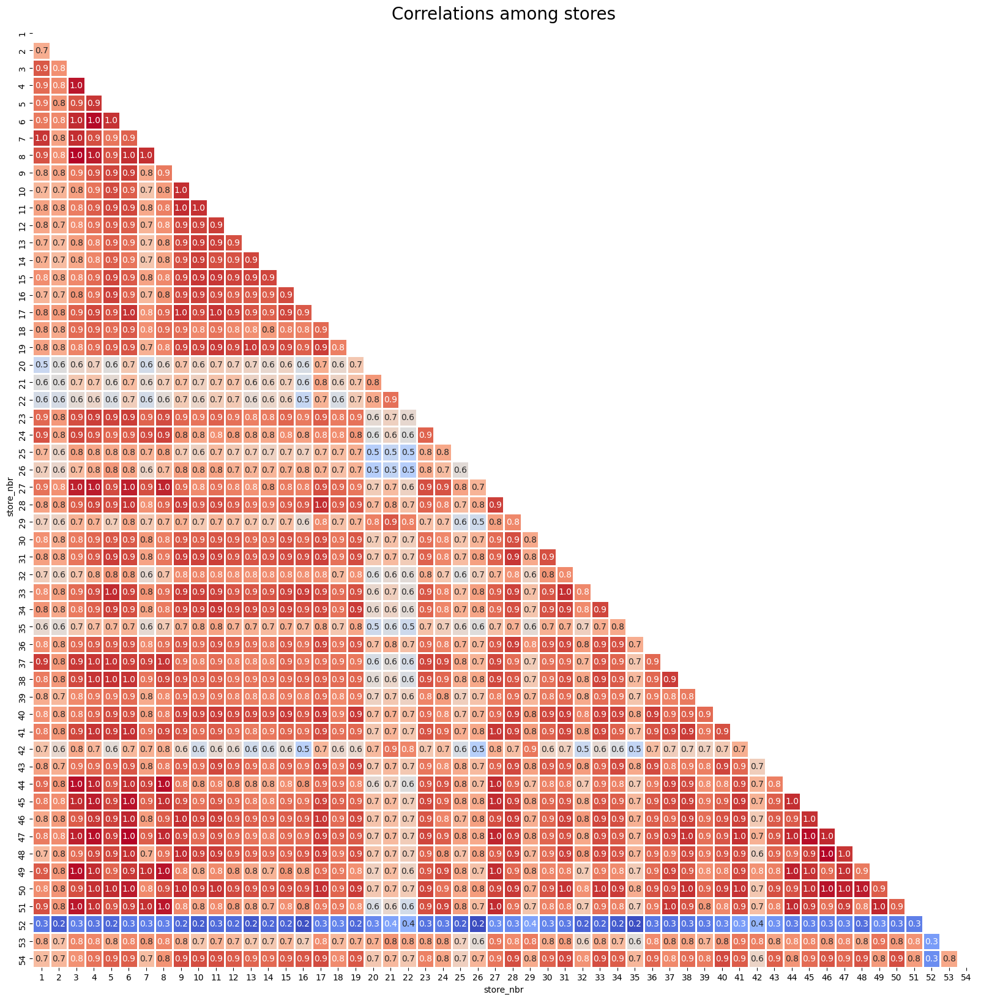

In [ ]:
train=train_data.copy()
train["date"] = pd.to_datetime(train.date)
a = train[["store_nbr", "sales"]]
a["ind"] = 1
a["ind"] = a.groupby("store_nbr").ind.cumsum().values
a = pd.pivot(a, index = "ind", columns = "store_nbr", values = "sales").corr()
mask = np.triu(a.corr())
plt.figure(figsize=(20, 20))
sns.heatmap(a,
        annot=True,
        fmt='.1f',
        cmap='coolwarm',
        square=True,
        mask=mask,
        linewidths=1,
        cbar=False)
plt.title("Correlations among stores",fontsize = 20)
plt.show()

There is a graph that shows us daily total sales below

In [ ]:
a = train.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
# set_index('date') đã làm date của a có tất cả các ngày, ko bị thiếu 25/12 nữa
px.line(a, x = "date", y= "sales", color = "store_nbr", title = "Daily total sales of the stores")

I realized some unnecessary rows in the data while I was looking at the time serie of the stores one by one. If you select the stores from above, some of them have no sales at the beginning of 2013. You can see them, if you look at the those stores 20, 21, 22, 29, 36, 42, 52 and 53. I decided to remove those rows before the stores opened. In the following codes, we will get rid of them.

Tôi nhận ra một số hàng không cần thiết trong dữ liệu khi tôi đang xem từng chuỗi thời gian của các cửa hàng. Nếu bạn chọn các cửa hàng ở trên, một số cửa hàng không có doanh số bán hàng vào đầu năm 2013. Bạn có thể thấy chúng, nếu bạn nhìn vào các cửa hàng 20, 21, 22, 29, 36, 42, 52 và 53. Tôi đã quyết định để xóa những hàng đó trước khi cửa hàng mở cửa. Trong các mã sau, chúng tôi sẽ loại bỏ chúng.

Và ngoài ra còn có vài cửa hàng trong vài ngày bất bất kì không có sales, ta sẽ thử nghiên cứu vấn đề này

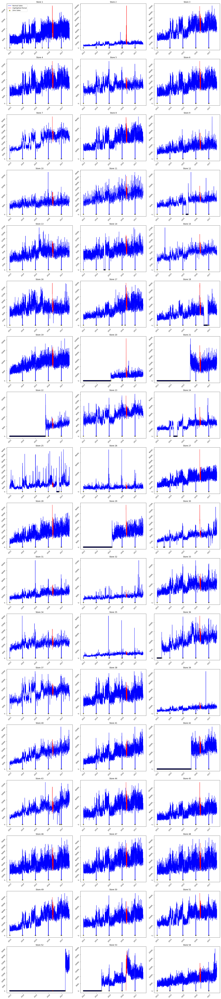

In [ ]:
# Define the start and end of the earthquake period
start_date = pd.to_datetime('2016-04-17')
end_date = pd.to_datetime('2016-05-16')

# Assuming 'a' is your DataFrame and it's already defined

# Convert 'date' column to datetime if not already
a['date'] = pd.to_datetime(a['date'])

# Get the unique store IDs from the DataFrame
store_ids = a['store_nbr'].unique()
# Determine the number of subplot rows needed, with up to 4 plots per row for example
n_rows = len(store_ids) // 3 + (len(store_ids) % 3 > 0)

# Create a figure with subplots
fig, axs = plt.subplots(n_rows, 3, figsize=(20, n_rows*5))  # Adjust figsize as needed

# Flatten the axes array for easy indexing
axs = axs.flatten()

# Loop through each store ID to create a plot in a subplot
for index, store_id in enumerate(store_ids):
    # Filter the DataFrame to only include sales for the current store
    store_data = a[a['store_nbr'] == store_id]

    # Plot data outside the specified range in blue
    normal_data = store_data[(store_data['date'] < start_date) | (store_data['date'] > end_date)]
    axs[index].plot(normal_data['date'], normal_data['sales'], color='blue', label='Normal Sales')

    # Highlight the specified date range in red
    highlight_data = store_data[(store_data['date'] >= start_date) & (store_data['date'] <= end_date)]
    axs[index].plot(highlight_data['date'], highlight_data['sales'], color='red', label='Highlighted Period')

    # Plot zero sales in yellow
    zero_sales_data = store_data[store_data['sales'] == 0]
    axs[index].scatter(zero_sales_data['date'], zero_sales_data['sales'], color='yellow', label='Zero Sales', edgecolor='black')

    axs[index].set_title(f'Store {store_id}')
    axs[index].tick_params(labelrotation=45)  # Rotate date labels for clarity

# Hide any unused subplots (if the number of stores isn't a multiple of 4)
for ax in axs[len(store_ids):]:
    ax.axis('off')

# Adjust layout to prevent overlap
plt.tight_layout()

# Add a legend to the first subplot for clarity, or to each subplot if preferred
axs[0].legend()

# Show the figure
plt.show()

This approach minimizes the computational load by:

Pre-computing averages and special cases outside the main DataFrame to avoid repetitive calculations.

Using vectorized operations for conditional checks and adjustments, significantly speeding up the process compared to row-wise operations.

Merging pre-computed values efficiently back into the main DataFrame to adjust sales as required.

Đây là những store ko có sale vào những ngày không có event, có thể lí do bảo trì, bị động đất,... Sẽ phải xử lí dữ liệu sales của những store trong ngày này vì không sẽ là outliers làm sai lệch kết quả

#5.OIL DATA
Ecuador is highly dependant on oil prices, therefore the prices of some items might be affected by variations in the oil prices.

The oil industry is driven by booms and busts. Prices typically rise during periods of global economic strength during which demand outpaces supply. Prices fall when the reverse is true, and supply exceeds demand. Meanwhile, oil supply and demand are driven by a number of key factors:

* Changes in the value of the U.S. dollar

* Changes in the policies of the Organization of Petroleum Exporting Countries (OPEC)

* Changes in the levels of oil production and inventory

* The health of the global economy

* The implementation (or collapse) of international agreements

Ecuador phụ thuộc nhiều vào giá dầu, do đó giá một số mặt hàng có thể bị ảnh hưởng bởi sự biến động của giá dầu.

Ngành công nghiệp dầu mỏ được thúc đẩy bởi sự bùng nổ và phá sản. Giá thường tăng trong thời kỳ sức mạnh kinh tế toàn cầu trong đó nhu cầu vượt xa nguồn cung. Giá giảm khi điều ngược lại là đúng và cung vượt quá cầu. Trong khi đó, cung và cầu dầu được thúc đẩy bởi một số yếu tố chính:

* Thay đổi giá trị của đồng đô la Mỹ

* Những thay đổi trong chính sách của Tổ chức các nước xuất khẩu dầu mỏ (OPEC)

* Những thay đổi về mức độ sản xuất và tồn kho dầu

* Sức khỏe của nền kinh tế toàn cầu

* Việc thực hiện (hoặc phá bỏ) các điều ước quốc tế

There are some missing data points in the daily oil data as you can see below. You can treat the data by using various imputation methods. However, I chose a simple solution for that. Linear Interpolation is suitable for this time serie. You can see the trend and predict missing data points, when you look at a time serie plot of oil price.

In [ ]:
train=train_data.copy()
oil=pd.read_csv(path+'oil.csv')
oil["date"] = pd.to_datetime(oil.date)
oil.loc[oil['date'] == '2013-01-01', 'dcoilwtico'] = 93.14
# Resample
oil = oil.set_index("date").dcoilwtico.resample("D").sum().reset_index()
# Interpolate
oil["dcoilwtico"] = np.where(oil["dcoilwtico"] == 0, np.nan, oil["dcoilwtico"])
oil["dcoilwtico_interpolated"] =oil.dcoilwtico.interpolate()

In [ ]:
oil

,date,dcoilwtico,dcoilwtico_interpolated
0,2013-01-01,93.14,93.140000
1,2013-01-02,93.14,93.140000
2,2013-01-03,92.97,92.970000
3,2013-01-04,93.12,93.120000
4,2013-01-05,NaN,93.146667
...,...,...,...
1699,2017-08-27,NaN,46.816667
1700,2017-08-28,46.40,46.400000
1701,2017-08-29,46.46,46.460000
1702,2017-08-30,45.96,45.960000


In [ ]:
#price of oil on 2013-01-01 (first element of the series) is missing, let´s fill it with the value of the next day and interpolate the next ones.
oil=pd.read_csv(path+'oil.csv')
oil.loc[oil['date'] == '2013-01-01', 'dcoilwtico'] = 93.14
oil = oil.interpolate(method='linear', limit=20)

## 5.1 Historic Oil Prices Chart

In [ ]:
##Let's look at the sales behavior for the whole data
train_aux = train[['date', 'sales']].groupby('date').mean()
train_aux = train_aux.reset_index()
fig = go.Figure(data=go.Scatter(x=oil['date'],
                                y=oil['dcoilwtico'],
                                marker_color='blue', text="sales"))


fig.update_layout({"title": f'Oil Prices Chart',
                   "xaxis": {"title":"Date"},
                   "yaxis": {"title":"Oil Price"},
                   "showlegend": False})
fig.show()

* Higher oil prices tend to make production more expensive for businesses, just as they make it more expensive for households to do the things they normally do. It turns out that oil and gasoline prices are indeed very closely related.
* At a consumer level, lower oil prices means more purchasing power for the customers. This explains why there's an increase in average sales since mid-2015.
* Oil prices will be used as a variable for training.

## 5.2 Avg Sales vs Oil Prices Chart

In [ ]:
train=train_data.copy()
#Scatter plot to the see correlation between average unit sold and oil price each day
sales_oil = train.groupby('date').mean()['sales']
sales_oil = sales_oil.reset_index()
sales_oil = pd.merge(sales_oil, oil, on ='date', how='left')
# we don't have all the oil prices available, we impute them
sales_oil = sales_oil.interpolate(method='linear', limit=20)

<ipython-input-69-48619af1e903>:3: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



In [ ]:
fig = px.scatter(sales_oil, x="dcoilwtico", y="sales", size='sales', color='sales',
                  color_continuous_scale="pinkyl")

fig.update_layout({"title": f'Correlation between Oil Prices and Sales (total avg sales and promotion each day)',
                   "xaxis": {"title":"Oil Price"},
                   "yaxis": {"title":"Sales"},
                   "showlegend": False})
fig.show()

The chart above clearly tells us that when there are lower oil prices the average units sold increases. Therefore, oil prices will be used as a variable for training.

Biểu đồ trên cho chúng ta biết rõ ràng rằng khi giá dầu giảm thì số lượng đơn vị bán ra trung bình sẽ tăng lên. Vì vậy, giá dầu sẽ được sử dụng làm biến số cho đào tạo.

## 5.3 Oil Lags

<ipython-input-71-bf751ea1e64e>:18: FutureWarning:

The default value of numeric_only in DataFrameGroupBy.mean is deprecated. In a future version, numeric_only will default to False. Either specify numeric_only or select only columns which should be valid for the function.



<Axes: >

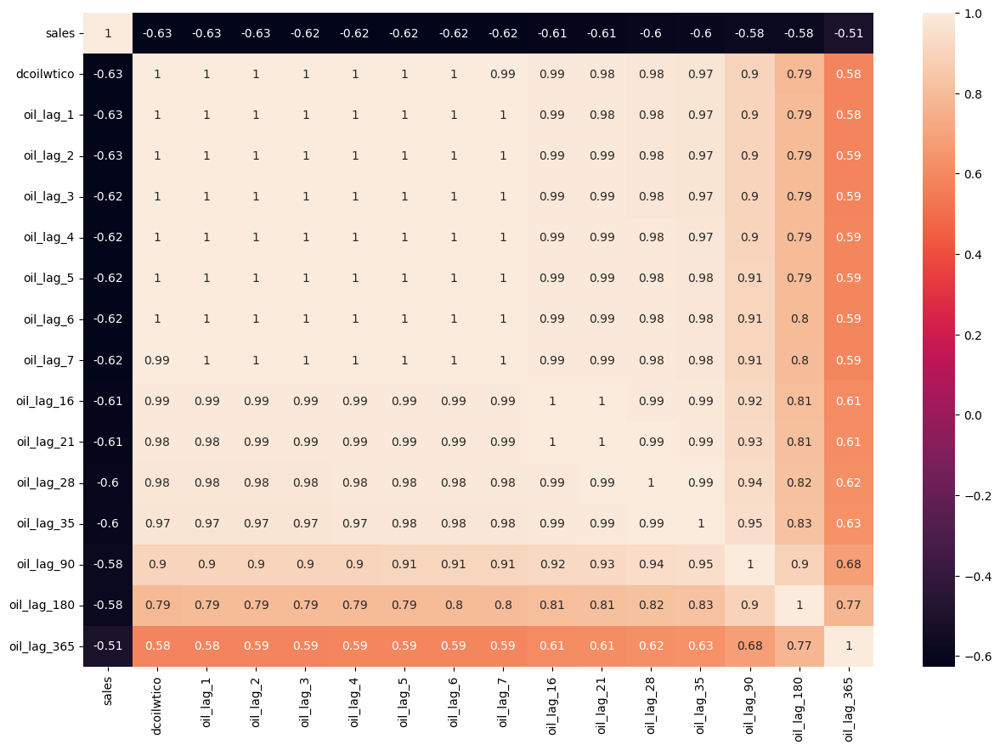

In [ ]:
oil.loc[oil['date'] == '2013-01-01', 'dcoilwtico'] = 93.14
oil = oil.interpolate(method='linear')
#oil['date'] = pd.to_datetime(oil['date'])
df_oil = pd.merge(train, oil, on='date', how='outer')
df_oil = df_oil.interpolate(method='ffill', limit=20000)

df_oil = df_oil[['date', 'dcoilwtico']].drop_duplicates().reset_index(drop=True)

#compute lags for oil price
LAGS_OIL = [1,2,3,4,5,6,7, 16,21,28,35, 90, 180, 365]

#compute lags for oil prices
df_lag_oil = df_oil.copy()
for lag in LAGS_OIL:
    df_lag_oil[f"oil_lag_{lag}"] = df_lag_oil['dcoilwtico'].transform(lambda x: x.shift(lag))

df_aux = pd.merge(train, df_lag_oil, on='date', how='left')
df_aux = df_aux.groupby('date').mean()[['sales', 'dcoilwtico'] + [col for col in list(df_aux.columns) if col.startswith('oil_lag')]].reset_index()
df_aux = df_aux[['sales', 'dcoilwtico'] + [col for col in list(df_aux.columns) if col.startswith('oil_lag')]]
plt.figure(figsize=(15,10))
sns.heatmap(df_aux.corr(), annot=True)

In [ ]:
oil.loc[oil['date'] == '2013-01-01', 'dcoilwtico'] = 93.14
oil = oil.interpolate(method='linear')
#oil['date'] = pd.to_datetime(oil['date'])
df_oil = pd.merge(train, oil, on='date', how='outer')
df_oil = df_oil.interpolate(method='ffill', limit=20000)

df_oil = df_oil[['date', 'dcoilwtico']].drop_duplicates().reset_index(drop=True)

#compute lags for oil price
LAGS_OIL = [1,2,3,4,5,6,7, 16,21,28,35, 90, 180, 365]

#compute lags for oil prices
df_lag_oil = df_oil.copy()
for lag in LAGS_OIL:
    df_lag_oil[f"oil_lag_{lag}"] = df_lag_oil['dcoilwtico'].transform(lambda x: x.shift(lag))

df_aux = pd.merge(train, df_lag_oil, on='date', how='left')

In [ ]:
df_aux

,date,store_nbr,family,sales,onpromotion,family_category,dcoilwtico,oil_lag_1,oil_lag_2,oil_lag_3,...,oil_lag_5,oil_lag_6,oil_lag_7,oil_lag_16,oil_lag_21,oil_lag_28,oil_lag_35,oil_lag_90,oil_lag_180,oil_lag_365
0,2013-01-01,1,AUTOMOTIVE,0.000,0,0,93.14,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2013-01-01,1,BABY CARE,0.000,0,1,93.14,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2013-01-01,1,BEAUTY,0.000,0,2,93.14,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,2013-01-01,1,BEVERAGES,0.000,0,3,93.14,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,2013-01-01,1,BOOKS,0.000,0,4,93.14,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3000883,2017-08-15,9,POULTRY,438.133,0,28,47.57,47.59,48.81,48.81,...,48.54,49.59,49.07,49.72,47.77,46.4,45.06,49.04,53.41,44.47
3000884,2017-08-15,9,PREPARED FOODS,154.553,1,29,47.57,47.59,48.81,48.81,...,48.54,49.59,49.07,49.72,47.77,46.4,45.06,49.04,53.41,44.47
3000885,2017-08-15,9,PRODUCE,2419.729,148,30,47.57,47.59,48.81,48.81,...,48.54,49.59,49.07,49.72,47.77,46.4,45.06,49.04,53.41,44.47
3000886,2017-08-15,9,SCHOOL AND OFFICE SUPPLIES,121.000,8,31,47.57,47.59,48.81,48.81,...,48.54,49.59,49.07,49.72,47.77,46.4,45.06,49.04,53.41,44.47


We can clearly see that lags close to the actual day have a high correlation with sales and dcoilwtico. It means that it is almost the same to use dcoilwtico and dcoilwtico lagged X days.

Actually, it would be better to use the oil price of 10-14 days ago to see the effect it has on sales and purchasing power. Poeple don´t refuel every day, they fill up the tank once or twice every 15 days. To see an effect it would more reasonable to use lagged oil price of 14-21 days ago, which has a 0.98-0.99 correlation with dcoilwtico

Chúng ta có thể thấy rõ rằng độ trễ gần với ngày thực tế có mối tương quan cao với doanh số bán hàng và dcoilwtico. Điều đó có nghĩa là việc sử dụng dcoilwtico và dcoilwtico bị trễ X ngày gần như giống nhau.

Trên thực tế, sẽ tốt hơn nếu sử dụng giá dầu của 10-14 ngày trước để xem ảnh hưởng của nó đến sức mua và sức mua. Người ta không đổ xăng mỗi ngày, họ đổ đầy bình một hoặc hai lần trong 15 ngày. Để thấy được hiệu quả, sẽ hợp lý hơn khi sử dụng giá dầu có độ trễ của 14-21 ngày trước, có mối tương quan 0,98-0,99 với dcoilwtico

# Basic FE and Baseline Model

In [ ]:
data_oil = pd.read_csv(path+'oil.csv')
train_data = pd.read_csv(path+'train.csv', index_col=0)
test_data = pd.read_csv(path+'test.csv', index_col=0)
samp_subm = pd.read_csv(path+'sample_submission.csv')
data_holi = pd.read_csv(path+'holidays_events.csv')
data_store =  pd.read_csv(path+'stores.csv')
data_trans = pd.read_csv(path+'transactions.csv')

# Datetime
train_data["date"] = pd.to_datetime(train_data.date)
test_data["date"] = pd.to_datetime(test_data.date)
data_trans["date"] = pd.to_datetime(data_trans.date)


# Data types
train_data.onpromotion = train_data.onpromotion.astype("float16")
train_data.sales = train_data.sales.astype("float32")
test_data.onpromotion = test_data.onpromotion.astype("float16")
data_store.cluster = data_store.cluster.astype("int8")

In [ ]:
def Check_null(df):
    # Check for nulls and sum them per column
    null_counts = df.isnull().sum()

    # Filter out columns that don't have null values
    null_columns = null_counts[null_counts > 0]

    if null_columns.empty:
        print("DataFrame does not have null values.")
    else:
        print("Check null:")
        print(null_columns)

## Data Preparing

### Store Open


In [ ]:
train=train_data.copy()
print(train.shape)
train = train[~((train.store_nbr == 52) & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]
train.shape

(3000888, 5)


(2780316, 5)

### Merging Datasets

In [ ]:
position = test_data.columns.get_loc('family') + 1

# Insert the new 'sales' column filled with zeros after the 'family' column
test_set_x = test_data.copy()
test_set_x.insert(position, 'sales', 0)
combined_df = pd.concat([train, test_set_x], ignore_index=True)

In [ ]:
# holidays[holidays.type == "Holiday"]
# holidays[(holidays.type == "Holiday") & (holidays.transferred == True)]
def Merge_data(df,holi_set_x, data_store, chose):
    # Transferred Holidays
    holidays = holi_set_x.copy()
    holidays["date"] = pd.to_datetime(holidays.date)
    tr1 = holidays[(holidays.type == "Holiday") & (holidays.transferred == True)].drop("transferred", axis = 1).reset_index(drop = True)
    tr2 = holidays[(holidays.type == "Transfer")].drop("transferred", axis = 1).reset_index(drop = True)
    tr = pd.concat([tr1,tr2], axis = 1)
    tr = tr.iloc[:, [5,1,2,3,4]]

    holidays = holidays[(holidays.transferred == False) & (holidays.type != "Transfer")].drop("transferred", axis = 1)
    holidays = holidays.append(tr).reset_index(drop = True)


    # Additional Holidays
    holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
    holidays["type"] = np.where(holidays["type"] == "Additional", "Holiday", holidays["type"])

    # Bridge Holidays
    holidays["description"] = holidays["description"].str.replace("Puente ", "")
    holidays["type"] = np.where(holidays["type"] == "Bridge", "Holiday", holidays["type"])


    # Work Day Holidays, that is meant to payback the Bridge.
    work_day = holidays[holidays.type == "Work Day"]
    holidays = holidays[holidays.type != "Work Day"]


    # Split

    # Events are national
    events = holidays[holidays.type == "Event"].drop(["type", "locale", "locale_name"], axis = 1).rename({"description":"events"}, axis = 1)

    holidays = holidays[holidays.type != "Event"].drop("type", axis = 1)
    regional = holidays[holidays.locale == "Regional"].rename({"locale_name":"state", "description":"holiday_regional"}, axis = 1).drop("locale", axis = 1).drop_duplicates()
    national = holidays[holidays.locale == "National"].rename({"description":"holiday_national"}, axis = 1).drop(["locale", "locale_name"], axis = 1).drop_duplicates()
    local = holidays[holidays.locale == "Local"].rename({"description":"holiday_local", "locale_name":"city"}, axis = 1).drop("locale", axis = 1).drop_duplicates()



    d = pd.merge(df, data_store)
    d["store_nbr"] = d["store_nbr"].astype("int8")


    # National Holidays & Events
    #d = pd.merge(d, events, how = "left")
    d = pd.merge(d, national, how = "left")
    # Regional
    d = pd.merge(d, regional, how = "left", on = ["date", "state"])
    # Local
    d = pd.merge(d, local, how = "left", on = ["date", "city"])


    # EVENTS
    events["events"] =np.where(events.events.str.contains("futbol"), "Futbol", events.events)

    def one_hot_encoder(df, nan_as_category=True):
        original_columns = list(df.columns)
        categorical_columns = df.select_dtypes(["category", "object"]).columns.tolist()
        # categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
        df = pd.get_dummies(df, columns=categorical_columns, dummy_na=nan_as_category)
        new_columns = [c for c in df.columns if c not in original_columns]
        df.columns = df.columns.str.replace(" ", "_")
        return df, df.columns.tolist()

    events, events_cat = one_hot_encoder(events, nan_as_category=False)
    events["events_Dia_de_la_Madre"] = np.where(events.date == "2016-05-08", 1,events["events_Dia_de_la_Madre"])
    events = events.drop(239)

    d = pd.merge(d, events, how = "left")
    d[events_cat] = d[events_cat].fillna(0)
    d
    # New features
    d["holiday_national_binary"] = np.where(d.holiday_national.notnull(), 1, 0)
    d["holiday_local_binary"] = np.where(d.holiday_local.notnull(), 1, 0)
    d["holiday_regional_binary"] = np.where(d.holiday_regional.notnull(), 1, 0)

    #
    d["national_independence"] = np.where(d.holiday_national.isin(['Batalla de Pichincha',  'Independencia de Cuenca', 'Independencia de Guayaquil', 'Independencia de Guayaquil', 'Primer Grito de Independencia']), 1, 0)
    d["local_cantonizacio"] = np.where(d.holiday_local.str.contains("Cantonizacio"), 1, 0)
    d["local_fundacion"] = np.where(d.holiday_local.str.contains("Fundacion"), 1, 0)
    d["local_independencia"] = np.where(d.holiday_local.str.contains("Independencia"), 1, 0)


    holidays, holidays_cat = one_hot_encoder(d[["holiday_national","holiday_regional","holiday_local"]], nan_as_category=False)
    d = pd.concat([d.drop(["holiday_national","holiday_regional","holiday_local"], axis = 1),holidays], axis = 1)

    he_cols = d.columns[d.columns.str.startswith("events")].tolist() + d.columns[d.columns.str.startswith("holiday")].tolist() + d.columns[d.columns.str.startswith("national")].tolist()+ d.columns[d.columns.str.startswith("local")].tolist()
    d[he_cols] = d[he_cols].astype("int8")


    if chose=='train':
        d = d[(d['date'] >= '2013-01-01') & (d['date'] <= '2017-08-15')]
    elif chose=='test':
        d = d[d['date'] > '2017-08-15']
        d = d.drop(['sales'], axis = 1)

    return d



In [ ]:
d = Merge_data(combined_df,holi_set_x,data_store,'train')
d

<ipython-input-12-d5826987ff9f>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  holidays = holidays.append(tr).reset_index(drop = True)
<ipython-input-12-d5826987ff9f>:17: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
<ipython-input-12-d5826987ff9f>:17: FutureWarning: The default value of regex will change from True to False in a future version.
  holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')


,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,events_Black_Friday,...,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,2013-01-01,1,AUTOMOTIVE,0.000000,0.0,Quito,Pichincha,D,13,0,...,0,0,0,0,0,0,0,0,0,0
1,2013-01-01,1,BABY CARE,0.000000,0.0,Quito,Pichincha,D,13,0,...,0,0,0,0,0,0,0,0,0,0
2,2013-01-01,1,BEAUTY,0.000000,0.0,Quito,Pichincha,D,13,0,...,0,0,0,0,0,0,0,0,0,0
3,2013-01-01,1,BEVERAGES,0.000000,0.0,Quito,Pichincha,D,13,0,...,0,0,0,0,0,0,0,0,0,0
4,2013-01-01,1,BOOKS,0.000000,0.0,Quito,Pichincha,D,13,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2808295,2017-08-15,52,POULTRY,397.339996,0.0,Manta,Manabi,A,11,0,...,0,0,0,0,0,0,0,0,0,0
2808296,2017-08-15,52,PREPARED FOODS,104.417999,0.0,Manta,Manabi,A,11,0,...,0,0,0,0,0,0,0,0,0,0
2808297,2017-08-15,52,PRODUCE,3803.367920,8.0,Manta,Manabi,A,11,0,...,0,0,0,0,0,0,0,0,0,0
2808298,2017-08-15,52,SCHOOL AND OFFICE SUPPLIES,17.000000,0.0,Manta,Manabi,A,11,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Store zero sales
https://www.officeholidays.com/countries/ecuador/2024

In [ ]:
# Find which store, which date have zero sales that not on event and holiday
train1=train.copy()
a = train1.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()


# Create a new DataFrame with only the necessary columns
df_zero_sales = a[['store_nbr', 'date', 'sales']]

# Filter the DataFrame to only include rows with zero sales
df_zero_sales = df_zero_sales[df_zero_sales['sales'] == 0]


###
# Define the dates to remove
dates_to_remove = [
    pd.to_datetime(f"{year}-01-01") for year in df_zero_sales['date'].dt.year
] + [
    pd.to_datetime(f"{year}-12-25") for year in df_zero_sales['date'].dt.year
]

# Filter the DataFrame to remove the specified dates
df_zero_sales_filtered = df_zero_sales[~df_zero_sales['date'].isin(dates_to_remove)]



In [ ]:
df_zero_sales_filtered

,store_nbr,date,sales
917,1,2015-07-07,0.0
19386,12,2015-03-30,0.0
19387,12,2015-03-31,0.0
19388,12,2015-04-01,0.0
19389,12,2015-04-02,0.0
...,...,...,...
45636,30,2013-07-30,0.0
67693,43,2016-11-14,0.0
67694,43,2016-11-15,0.0
67695,43,2016-11-16,0.0


In [ ]:
# Assuming 'd' is your original dataframe
stores_list = df_zero_sales_filtered['store_nbr'].unique()

# Create an empty dictionary to store each store's dataframe
stores_dataframes = {}

for store in stores_list:
    # Filter the dataframe for the current store number
    store_df = d[d['store_nbr'] == store]
    # Store the filtered dataframe in the dictionary
    stores_dataframes[f'store_{store}'] = store_df

for store_number in stores_list:
    # Dynamically create variable names and assign the corresponding dataframe
    # Note: Using exec() is generally discouraged due to security and readability concerns
    exec(f"store_{store_number}_df = stores_dataframes['store_{store_number}']")

# List of all DataFrames and their corresponding store identifiers
dataframes = []
for store in stores_list:
  dataframes.append(eval(f"store_{store}_df"))

# Add a 'store_id' column to each DataFrame and concatenate them into one DataFrame
for i, df in enumerate(dataframes):
    df['store_nbr'] = stores_list[i]
combined_df = pd.concat(dataframes)

# Calculate the average sales for each family across each store
average_sales_df = combined_df.groupby(['store_nbr', 'family'])['sales'].mean().reset_index(name='average_sales')

# Replace sales for that store doesn't have sales
# Merge d with df_zero_sales_filtered to flag rows where sales should be replaced
# This assumes df_zero_sales_filtered contains columns 'store_nbr' and 'date' indicating where sales are zero
d = d.merge(df_zero_sales_filtered[['store_nbr', 'date']].drop_duplicates(), on=['store_nbr', 'date'], how='left', indicator=True)
d['replace_sales'] = d['_merge'] == 'both'
d.drop('_merge', axis=1, inplace=True)

# Merge d with average_sales_df to get the average sales per store_nbr and family
d = d.merge(average_sales_df, on=['store_nbr', 'family'], how='left', suffixes=('', '_avg'))

# Update the sales column where replace_sales is True
d['sales'] = d.apply(lambda x: x['average_sales'] if x['replace_sales'] else x['sales'], axis=1)

# Drop the columns used for processing
d.drop(['replace_sales', 'average_sales'], axis=1, inplace=True)

<ipython-input-15-3bdb0bc9b175>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['store_nbr'] = stores_list[i]


In [ ]:
# Replace sales for that store doesn't have sales
# Merge d with df_zero_sales_filtered to flag rows where sales should be replaced
# This assumes df_zero_sales_filtered contains columns 'store_nbr' and 'date' indicating where sales are zero
d = d.merge(df_zero_sales_filtered[['store_nbr', 'date']].drop_duplicates(), on=['store_nbr', 'date'], how='left', indicator=True)
d['replace_sales'] = d['_merge'] == 'both'
d.drop('_merge', axis=1, inplace=True)

# Merge d with average_sales_df to get the average sales per store_nbr and family
d = d.merge(average_sales_df, on=['store_nbr', 'family'], how='left', suffixes=('', '_avg'))

# Update the sales column where replace_sales is True
d['sales'] = d.apply(lambda x: x['average_sales'] if x['replace_sales'] else x['sales'], axis=1)

# Drop the columns used for processing
d.drop(['replace_sales', 'average_sales'], axis=1, inplace=True)

In [ ]:
print(d[(d['store_nbr'] == 12) & (d['date'] == '2015-04-02')])

             date  store_nbr                      family        sales  \
193743 2015-04-02         12                  AUTOMOTIVE     4.752969   
193744 2015-04-02         12                   BABY CARE     0.106295   
193745 2015-04-02         12                      BEAUTY     0.966746   
193746 2015-04-02         12                   BEVERAGES  1296.450073   
193747 2015-04-02         12                       BOOKS     0.000000   
193748 2015-04-02         12                BREAD/BAKERY   186.521378   
193749 2015-04-02         12                 CELEBRATION     6.142518   
193750 2015-04-02         12                    CLEANING   771.797485   
193751 2015-04-02         12                       DAIRY   335.396667   
193752 2015-04-02         12                        DELI   196.566513   
193753 2015-04-02         12                        EGGS    74.950714   
193754 2015-04-02         12                FROZEN FOODS    47.622417   
193755 2015-04-02         12                   GROC

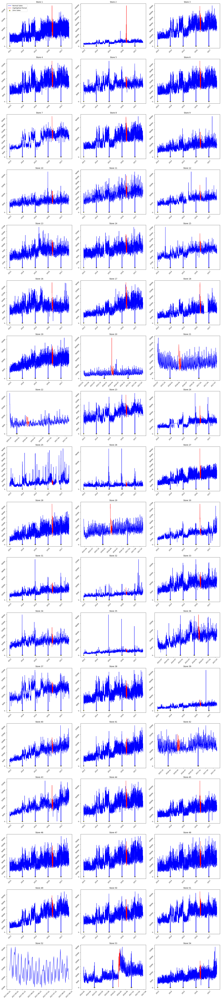

In [ ]:
a = d.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
# Define the start and end of the earthquake period
start_date = pd.to_datetime('2016-04-17')
end_date = pd.to_datetime('2016-05-16')

# Assuming 'a' is your DataFrame and it's already defined

# Convert 'date' column to datetime if not already
a['date'] = pd.to_datetime(a['date'])

# Get the unique store IDs from the DataFrame
store_ids = a['store_nbr'].unique()
# Determine the number of subplot rows needed, with up to 4 plots per row for example
n_rows = len(store_ids) // 3 + (len(store_ids) % 3 > 0)

# Create a figure with subplots
fig, axs = plt.subplots(n_rows, 3, figsize=(20, n_rows*5))  # Adjust figsize as needed

# Flatten the axes array for easy indexing
axs = axs.flatten()

# Loop through each store ID to create a plot in a subplot
for index, store_id in enumerate(store_ids):
    # Filter the DataFrame to only include sales for the current store
    store_data = a[a['store_nbr'] == store_id]

    # Plot data outside the specified range in blue
    normal_data = store_data[(store_data['date'] < start_date) | (store_data['date'] > end_date)]
    axs[index].plot(normal_data['date'], normal_data['sales'], color='blue', label='Normal Sales')

    # Highlight the specified date range in red
    highlight_data = store_data[(store_data['date'] >= start_date) & (store_data['date'] <= end_date)]
    axs[index].plot(highlight_data['date'], highlight_data['sales'], color='red', label='Highlighted Period')

    # Plot zero sales in yellow
    zero_sales_data = store_data[store_data['sales'] == 0]
    axs[index].scatter(zero_sales_data['date'], zero_sales_data['sales'], color='yellow', label='Zero Sales', edgecolor='black')

    axs[index].set_title(f'Store {store_id}')
    axs[index].tick_params(labelrotation=45)  # Rotate date labels for clarity

# Hide any unused subplots (if the number of stores isn't a multiple of 4)
for ax in axs[len(store_ids):]:
    ax.axis('off')

# Adjust layout to prevent overlap
plt.tight_layout()

# Add a legend to the first subplot for clarity, or to each subplot if preferred
axs[0].legend()

# Show the figure
plt.show()

In [ ]:
stores_list = df_zero_sales_filtered['store_nbr'].unique()
print(stores_list)

[ 1 12 14 17 18 24 25 30 43]


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Encoding

In [ ]:
def Encoding(df,train_data,data_store):
    def one_hot_encoder(df, nan_as_category=True):
        original_columns = list(df.columns)
        categorical_columns = df.select_dtypes(["category", "object"]).columns.tolist()
        # categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
        df = pd.get_dummies(df, columns=categorical_columns, dummy_na=nan_as_category, dtype=int)
        new_columns = [c for c in df.columns if c not in original_columns]
        df.columns = df.columns.str.replace(" ", "_")
        return df, df.columns.tolist()

    train_data, train_data_cat = one_hot_encoder(train_data, nan_as_category=False)
    df = pd.merge(df, train_data, how = "left")
    df[train_data_cat] = df[train_data_cat].fillna(0)

    data_store, data_store_cat = one_hot_encoder(data_store, nan_as_category=False)
    df = pd.merge(df, data_store, how = "left")
    df[data_store_cat] = df[data_store_cat].fillna(0)

    df = df.drop(["family","city","state","type"], axis = 1)
    return df

In [ ]:
d=Encoding(d,train_data,data_store)
d.head()

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,...,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E
0,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
1,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
2,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
3,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
4,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Merge oil data

In [ ]:
def Merge_oil(chose,df):
    if chose=='d':
        p=path+'train.csv'
    elif chose=='e':
        p=path+'test.csv'

    data = pd.read_csv(p)
    oil=pd.read_csv(path+'oil.csv')
    oil.loc[oil['date'] == '2013-01-01', 'dcoilwtico'] = 93.14
    oil = oil.interpolate(method='linear')

    df_oil = pd.merge(data, oil, on='date', how='outer')
    df_oil = df_oil.interpolate(method='ffill', limit=20000)

    df_oil = df_oil[['date', 'dcoilwtico']].drop_duplicates().reset_index(drop=True)
    df_oil['date'] = pd.to_datetime(df_oil['date'])

    df = pd.merge(df, df_oil, on='date', how='left')
    return df

In [ ]:
d=Merge_oil('d',d)
d.head()

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,...,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico
0,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
1,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
2,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
3,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
4,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Time data

In [ ]:
# Time Related Features
def create_date_features(df):
    # Create a dictionary to hold new columns
    new_columns = {
        'month': df.date.dt.month.astype("int8"),
        'day_of_month': df.date.dt.day.astype("int8"),
        'day_of_year': df.date.dt.dayofyear.astype("int16"),
        'week_of_month': ((df.date.apply(lambda d: (d.day-1) // 7 + 1))).astype("int8"),
        'week_of_year': df.date.dt.isocalendar().week.astype("int8"),
        'day_of_week': (df.date.dt.dayofweek + 1).astype("int8"),
        'year': df.date.dt.year.astype("int32"),
    }
    new_columns_df = pd.DataFrame(new_columns, index=df.index)


    # Concatenate the original DataFrame with the new columns
    df = pd.concat([df, new_columns_df], axis=1)

    return df


# Example usage
d = create_date_features(d)


In [ ]:
d.head()

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,...,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year
0,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
1,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
2,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
3,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
4,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Train test split


In [ ]:
train_start_date = '2013-01-01'
train_end_date = '2017-07-31'
valid_start_date = '2017-08-01'
valid_end_date = '2017-08-15'

X_train_1 = d[(d['date'] >= train_start_date) & (d['date'] <= train_end_date)]
X_valid_1 = d[(d['date'] >= valid_start_date) & (d['date'] <= valid_end_date)]
y_train_1 = pd.DataFrame(X_train_1.sales,columns = ['sales'], index = X_train_1.index)
y_valid_1 = pd.DataFrame(X_valid_1.sales,columns = ['sales'], index = X_valid_1.index)

In [ ]:
date_df = pd.DataFrame()
date_df['date'] = X_valid_1['date']

In [ ]:
date_df

,date
182474,2017-08-01
182475,2017-08-01
182476,2017-08-01
182477,2017-08-01
182478,2017-08-01
...,...
10383478,2017-08-15
10383479,2017-08-15
10383480,2017-08-15
10383481,2017-08-15


In [ ]:
def drop_rows (data):
    data.drop(['date'], axis='columns', inplace=True)
    data.drop(['sales'], axis='columns', inplace=True)
    return data

drop_rows(X_train_1)
drop_rows(X_valid_1)

<ipython-input-133-69ab4611cc3c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop(['date'], axis='columns', inplace=True)
<ipython-input-133-69ab4611cc3c>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop(['sales'], axis='columns', inplace=True)
<ipython-input-133-69ab4611cc3c>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data.drop(['date'], axis='columns', inplace=True)
<ipython-input-133-69ab4611cc3c>:3: Settin

,store_nbr,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,...,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year
182539,1,0.0,13,0,0,0,0,0,0,0,...,1,0,49.19,8,1,213,1,31,2,2017
182540,1,0.0,13,0,0,0,0,0,0,0,...,1,0,49.19,8,1,213,1,31,2,2017
182541,1,0.0,13,0,0,0,0,0,0,0,...,1,0,49.19,8,1,213,1,31,2,2017
182542,1,0.0,13,0,0,0,0,0,0,0,...,1,0,49.19,8,1,213,1,31,2,2017
182543,1,0.0,13,0,0,0,0,0,0,0,...,1,0,49.19,8,1,213,1,31,2,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10369447,52,0.0,11,0,0,0,0,0,0,0,...,0,0,47.57,8,15,227,3,33,2,2017
10369448,52,8.0,11,0,0,0,0,0,0,0,...,0,0,47.57,8,15,227,3,33,2,2017
10369449,52,0.0,11,0,0,0,0,0,0,0,...,0,0,47.57,8,15,227,3,33,2,2017
10369450,52,0.0,11,0,0,0,0,0,0,0,...,0,0,47.57,8,15,227,3,33,2,2017


## Modelling

In [ ]:
from sklearn.linear_model import LinearRegression

In [ ]:
model = LinearRegression(positive=True)
model.fit(X_train_1, y_train_1)
predictions = model.predict(X_valid_1)

In [ ]:
predictions_baseline = pd.DataFrame(data=predictions, columns=['sales'], index=y_valid_1.index)
predictions_baseline[predictions_baseline < 0] = 0
predictions_baseline = pd.merge(predictions_baseline, y_valid_1, on=predictions_baseline.index, suffixes=('_predict', '_true'))
predictions_baseline = predictions_baseline.set_index('key_0')
predictions_baseline.head()

,sales_predict,sales_true
key_0,,
182539,71.003906,5.0
182540,75.421875,5.0
182541,71.003906,0.0
182542,71.003906,0.0
182543,71.957031,0.0


In [ ]:
print(root_mean_squared_log_error(predictions_baseline['sales_true'], predictions_baseline['sales_predict']))

2.461708380467986


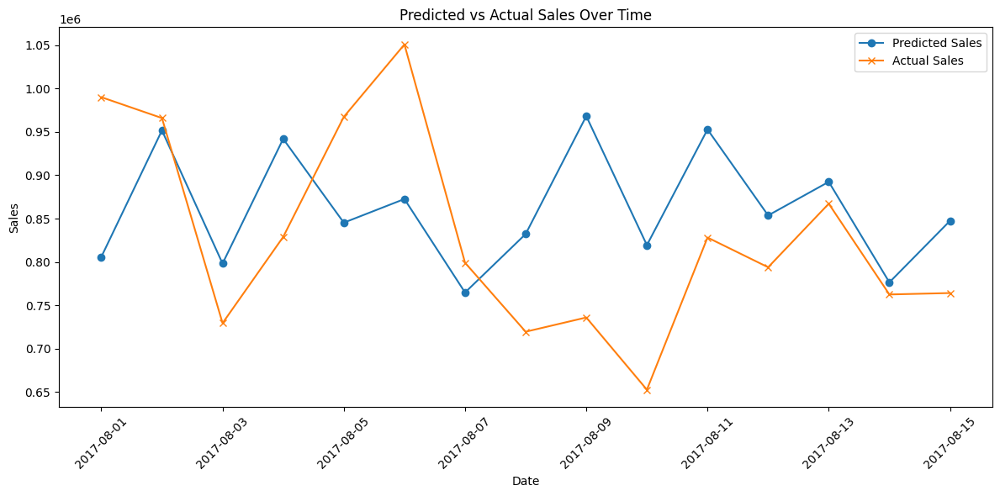

In [ ]:
#plot prediction
predictions_plot = predictions_baseline.merge(date_df['date'], left_on='key_0', right_index=True)
predictions_plot = predictions_plot.groupby('date').agg({
    'sales_predict': 'sum',
    'sales_true': 'sum'
}).reset_index()

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(predictions_plot['date'], predictions_plot['sales_predict'], label='Predicted Sales', marker='o')
plt.plot(predictions_plot['date'], predictions_plot['sales_true'], label='Actual Sales', marker='x')

plt.title('Predicted vs Actual Sales Over Time')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend()
plt.xticks(rotation=45)  # Rotate date labels for better readability

plt.tight_layout()
plt.show()

## Test data

In [ ]:
e = Merge_data(combined_df,holi_set_x,data_store,'test')
e.head()

<ipython-input-115-31741146d1c2>:13: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  holidays = holidays.append(tr).reset_index(drop = True)
<ipython-input-115-31741146d1c2>:17: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
<ipython-input-115-31741146d1c2>:17: FutureWarning: The default value of regex will change from True to False in a future version.
  holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')


,date,store_nbr,family,onpromotion,city,state,type,cluster,events_Black_Friday,events_Cyber_Monday,...,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
55572,2017-08-16,1,AUTOMOTIVE,0.0,Quito,Pichincha,D,13,0,0,...,0,0,0,0,0,0,0,0,0,0
55573,2017-08-16,1,BABY CARE,0.0,Quito,Pichincha,D,13,0,0,...,0,0,0,0,0,0,0,0,0,0
55574,2017-08-16,1,BEAUTY,2.0,Quito,Pichincha,D,13,0,0,...,0,0,0,0,0,0,0,0,0,0
55575,2017-08-16,1,BEVERAGES,20.0,Quito,Pichincha,D,13,0,0,...,0,0,0,0,0,0,0,0,0,0
55576,2017-08-16,1,BOOKS,0.0,Quito,Pichincha,D,13,0,0,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
e=Encoding(e,train_data,data_store)
e.head()

,date,store_nbr,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,...,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E
0,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
1,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
2,2017-08-16,1,2.0,13,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
3,2017-08-16,1,20.0,13,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
4,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0


In [ ]:
e=Merge_oil('e',e)
e.head()

,date,store_nbr,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,...,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico
0,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,46.8
1,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,46.8
2,2017-08-16,1,2.0,13,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,46.8
3,2017-08-16,1,20.0,13,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,46.8
4,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,1,0,0,0,0,0,0,1,0,46.8


In [ ]:
e = create_date_features(e)
e.head()

,date,store_nbr,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,...,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year
0,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,1,0,46.8,8,16,228,3,33,3,2017
1,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,1,0,46.8,8,16,228,3,33,3,2017
2,2017-08-16,1,2.0,13,0,0,0,0,0,0,...,1,0,46.8,8,16,228,3,33,3,2017
3,2017-08-16,1,20.0,13,0,0,0,0,0,0,...,1,0,46.8,8,16,228,3,33,3,2017
4,2017-08-16,1,0.0,13,0,0,0,0,0,0,...,1,0,46.8,8,16,228,3,33,3,2017


In [ ]:
Check_null(e)

DataFrame does not have null values.


In [ ]:
def drop_rows (data):
    data.drop(['date'], axis='columns', inplace=True)
    data.drop(['sales'], axis='columns', inplace=True)
    return data

drop_rows(e)

,store_nbr,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,holiday_national_binary,holiday_local_binary,...,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year
0,1,0.0,13,0,0,0,0,0,0,0,...,1,0,46.80,8,16,228,3,33,3,2017
1,1,0.0,13,0,0,0,0,0,0,0,...,1,0,46.80,8,16,228,3,33,3,2017
2,1,2.0,13,0,0,0,0,0,0,0,...,1,0,46.80,8,16,228,3,33,3,2017
3,1,20.0,13,0,0,0,0,0,0,0,...,1,0,46.80,8,16,228,3,33,3,2017
4,1,0.0,13,0,0,0,0,0,0,0,...,1,0,46.80,8,16,228,3,33,3,2017
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
28507,52,0.0,11,0,0,0,0,0,0,0,...,0,0,47.26,8,31,243,5,35,4,2017
28508,52,0.0,11,0,0,0,0,0,0,0,...,0,0,47.26,8,31,243,5,35,4,2017
28509,52,3.0,11,0,0,0,0,0,0,0,...,0,0,47.26,8,31,243,5,35,4,2017
28510,52,0.0,11,0,0,0,0,0,0,0,...,0,0,47.26,8,31,243,5,35,4,2017


In [ ]:
predictions = model.predict(e)

In [ ]:
predictions_baseline_test = pd.DataFrame(data=predictions, columns=['sales'], index=e.index)
predictions_baseline_test[predictions_baseline_test < 0] = 0
predictions_baseline_test.index = test_data.index
predictions_baseline_test.index.name = 'id'
predictions_baseline_test.head()

,sales
id,
3000888,88.519531
3000889,88.519531
3000890,129.941406
3000891,502.757812
3000892,88.519531


In [ ]:
predictions_baseline_test.to_csv('/content/drive/MyDrive/Coding_DS/Project Store sales/Submission/predictions_baseline_test.csv', index=True)

In [ ]:
# Download the dataframe as a CSV file
predictions_baseline_test.to_csv('submission1.csv', index=True)

# Download the file to your computer
from google.colab import files
files.download('submission1.csv')
#score 2.37916

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# FE and Model Tunning

In [ ]:
data_oil = pd.read_csv(path+'oil.csv')
train_data = pd.read_csv(path+'train.csv', index_col=0)
test_data = pd.read_csv(path+'test.csv', index_col=0)
samp_subm = pd.read_csv(path+'sample_submission.csv')
data_holi = pd.read_csv(path+'holidays_events.csv')
data_store =  pd.read_csv(path+'stores.csv')
data_trans = pd.read_csv(path+'transactions.csv')

# Datetime
train_data["date"] = pd.to_datetime(train_data.date)
test_data["date"] = pd.to_datetime(test_data.date)
data_trans["date"] = pd.to_datetime(data_trans.date)


# Data types
train_data.onpromotion = train_data.onpromotion.astype("float16")
train_data.sales = train_data.sales.astype("float32")
data_store.cluster = data_store.cluster.astype("int8")

In [ ]:
def Check_null(df):
    # Check for nulls and sum them per column
    null_counts = df.isnull().sum()

    # Filter out columns that don't have null values
    null_columns = null_counts[null_counts > 0]

    if null_columns.empty:
        print("DataFrame does not have null values.")
    else:
        print("Check null:")
        print(null_columns)

## Data Preparing

### Store Open


In [ ]:
train=train_data.copy()
print(train.shape)
train = train[~((train.store_nbr == 52) & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]
train.shape

(3000888, 5)


(2780316, 5)

### Merging Datasets

In [ ]:
position = test_data.columns.get_loc('family') + 1

# Insert the new 'sales' column filled with zeros after the 'family' column
test_set_x = test_data.copy()
test_set_x.insert(position, 'sales', 0)
combined_df = pd.concat([train, test_set_x], ignore_index=True)

In [ ]:
def Merge_data(df,data_holi, data_store, chose):
    # Transferred Holidays
    holidays = data_holi.copy()
    holidays["date"] = pd.to_datetime(holidays.date)
    tr1 = holidays[(holidays.type == "Holiday") & (holidays.transferred == True)].drop("transferred", axis = 1).reset_index(drop = True)
    tr2 = holidays[(holidays.type == "Transfer")].drop("transferred", axis = 1).reset_index(drop = True)
    tr = pd.concat([tr1,tr2], axis = 1)
    tr = tr.iloc[:, [5,1,2,3,4]]

    holidays = holidays[(holidays.transferred == False) & (holidays.type != "Transfer")].drop("transferred", axis = 1)
    holidays = holidays.append(tr).reset_index(drop = True)


    # Additional Holidays
    holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
    holidays["type"] = np.where(holidays["type"] == "Additional", "Holiday", holidays["type"])

    # Bridge Holidays
    holidays["description"] = holidays["description"].str.replace("Puente ", "")
    holidays["type"] = np.where(holidays["type"] == "Bridge", "Holiday", holidays["type"])


    # Work Day Holidays, that is meant to payback the Bridge.
    work_day = holidays[holidays.type == "Work Day"]
    holidays = holidays[holidays.type != "Work Day"]


    # Split

    # Events are national
    events = holidays[holidays.type == "Event"].drop(["type", "locale", "locale_name"], axis = 1).rename({"description":"events"}, axis = 1)

    holidays = holidays[holidays.type != "Event"].drop("type", axis = 1)
    regional = holidays[holidays.locale == "Regional"].rename({"locale_name":"state", "description":"holiday_regional"}, axis = 1).drop("locale", axis = 1).drop_duplicates()
    national = holidays[holidays.locale == "National"].rename({"description":"holiday_national"}, axis = 1).drop(["locale", "locale_name"], axis = 1).drop_duplicates()
    local = holidays[holidays.locale == "Local"].rename({"description":"holiday_local", "locale_name":"city"}, axis = 1).drop("locale", axis = 1).drop_duplicates()



    d = pd.merge(df, data_store)
    d["store_nbr"] = d["store_nbr"].astype("int8")


    # National Holidays & Events
    #d = pd.merge(d, events, how = "left")
    d = pd.merge(d, national, how = "left")
    # Regional
    d = pd.merge(d, regional, how = "left", on = ["date", "state"])
    # Local
    d = pd.merge(d, local, how = "left", on = ["date", "city"])
    # Work Day: It will be removed when real work day colum created
    #d = pd.merge(d,  work_day[["date", "type"]].rename({"type":"IsWorkDay"}, axis = 1),how = "left")

    # EVENTS
    events["events"] =np.where(events.events.str.contains("futbol"), "Futbol", events.events)

    def one_hot_encoder(df, nan_as_category=True):
        original_columns = list(df.columns)
        categorical_columns = df.select_dtypes(["category", "object"]).columns.tolist()
        # categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
        df = pd.get_dummies(df, columns=categorical_columns, dummy_na=nan_as_category)
        new_columns = [c for c in df.columns if c not in original_columns]
        df.columns = df.columns.str.replace(" ", "_")
        return df, df.columns.tolist()

    events, events_cat = one_hot_encoder(events, nan_as_category=False)
    events["events_Dia_de_la_Madre"] = np.where(events.date == "2016-05-08", 1,events["events_Dia_de_la_Madre"])
    events = events.drop(239)

    d = pd.merge(d, events, how = "left")
    d[events_cat] = d[events_cat].fillna(0)

    # pattern = re.compile(r'^events_Terremoto_Manabi\d+$')
    # # Identify columns that match the pattern
    # columns_to_drop = [column for column in d.columns if pattern.match(column)]
    # # Drop the identified columns
    # d.drop(columns=columns_to_drop, inplace=True)

    # New features
    d["holiday_national_binary"] = np.where(d.holiday_national.notnull(), 1, 0)
    d["holiday_local_binary"] = np.where(d.holiday_local.notnull(), 1, 0)
    d["holiday_regional_binary"] = np.where(d.holiday_regional.notnull(), 1, 0)

    #
    d["national_independence"] = np.where(d.holiday_national.isin(['Batalla de Pichincha',  'Independencia de Cuenca', 'Independencia de Guayaquil', 'Independencia de Guayaquil', 'Primer Grito de Independencia']), 1, 0)
    d["local_cantonizacio"] = np.where(d.holiday_local.str.contains("Cantonizacio"), 1, 0)
    d["local_fundacion"] = np.where(d.holiday_local.str.contains("Fundacion"), 1, 0)
    d["local_independencia"] = np.where(d.holiday_local.str.contains("Independencia"), 1, 0)


    holidays, holidays_cat = one_hot_encoder(d[["holiday_national","holiday_regional","holiday_local"]], nan_as_category=False)
    d = pd.concat([d.drop(["holiday_national","holiday_regional","holiday_local"], axis = 1),holidays], axis = 1)

    he_cols = d.columns[d.columns.str.startswith("events")].tolist() + d.columns[d.columns.str.startswith("holiday")].tolist() + d.columns[d.columns.str.startswith("national")].tolist()+ d.columns[d.columns.str.startswith("local")].tolist()
    d[he_cols] = d[he_cols].astype("int8")

    if chose=='train':
        d = d[(d['date'] >= '2013-01-01') & (d['date'] <= '2017-08-15')]
    elif chose=='test':
        d = d[d['date'] > '2017-08-15']
        d = d.drop(['sales'], axis = 1)

    return d



In [ ]:
d = Merge_data(combined_df,data_holi,data_store,'train')
d

<ipython-input-11-c8dd2ee5c178>:15: FutureWarning: The default value of regex will change from True to False in a future version. In addition, single character regular expressions will *not* be treated as literal strings when regex=True.
  holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')
<ipython-input-11-c8dd2ee5c178>:15: FutureWarning: The default value of regex will change from True to False in a future version.
  holidays["description"] = holidays["description"].str.replace("-", "").str.replace("+", "").str.replace('\d+', '')


,date,store_nbr,family,sales,onpromotion,city,state,type,cluster,IsWorkDay,...,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
0,2013-01-01,1,AUTOMOTIVE,0.000000,0.0,Quito,Pichincha,D,13,NaN,...,0,0,0,0,0,0,0,0,0,0
1,2013-01-01,1,BABY CARE,0.000000,0.0,Quito,Pichincha,D,13,NaN,...,0,0,0,0,0,0,0,0,0,0
2,2013-01-01,1,BEAUTY,0.000000,0.0,Quito,Pichincha,D,13,NaN,...,0,0,0,0,0,0,0,0,0,0
3,2013-01-01,1,BEVERAGES,0.000000,0.0,Quito,Pichincha,D,13,NaN,...,0,0,0,0,0,0,0,0,0,0
4,2013-01-01,1,BOOKS,0.000000,0.0,Quito,Pichincha,D,13,NaN,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2808295,2017-08-15,52,POULTRY,397.339996,0.0,Manta,Manabi,A,11,NaN,...,0,0,0,0,0,0,0,0,0,0
2808296,2017-08-15,52,PREPARED FOODS,104.417999,0.0,Manta,Manabi,A,11,NaN,...,0,0,0,0,0,0,0,0,0,0
2808297,2017-08-15,52,PRODUCE,3803.367920,8.0,Manta,Manabi,A,11,NaN,...,0,0,0,0,0,0,0,0,0,0
2808298,2017-08-15,52,SCHOOL AND OFFICE SUPPLIES,17.000000,0.0,Manta,Manabi,A,11,NaN,...,0,0,0,0,0,0,0,0,0,0


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Store zero sales
https://www.officeholidays.com/countries/ecuador/2024

In [ ]:
# Find which store, which date have zero sales that not on event and holiday
train1=train.copy()
a = train1.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()


# Create a new DataFrame with only the necessary columns
df_zero_sales = a[['store_nbr', 'date', 'sales']]

# Filter the DataFrame to only include rows with zero sales
df_zero_sales = df_zero_sales[df_zero_sales['sales'] == 0]


###
# Define the dates to remove
dates_to_remove = [
    pd.to_datetime(f"{year}-01-01") for year in df_zero_sales['date'].dt.year
] + [
    pd.to_datetime(f"{year}-12-25") for year in df_zero_sales['date'].dt.year
]

# Filter the DataFrame to remove the specified dates
df_zero_sales_filtered = df_zero_sales[~df_zero_sales['date'].isin(dates_to_remove)]



In [ ]:
df_zero_sales_filtered

,store_nbr,date,sales
917,1,2015-07-07,0.0
19386,12,2015-03-30,0.0
19387,12,2015-03-31,0.0
19388,12,2015-04-01,0.0
19389,12,2015-04-02,0.0
...,...,...,...
45636,30,2013-07-30,0.0
67693,43,2016-11-14,0.0
67694,43,2016-11-15,0.0
67695,43,2016-11-16,0.0


In [ ]:
# Assuming 'd' is your original dataframe
stores_list = df_zero_sales_filtered['store_nbr'].unique()

# Create an empty dictionary to store each store's dataframe
stores_dataframes = {}

for store in stores_list:
    # Filter the dataframe for the current store number
    store_df = d[d['store_nbr'] == store]
    # Store the filtered dataframe in the dictionary
    stores_dataframes[f'store_{store}'] = store_df

for store_number in stores_list:
    # Dynamically create variable names and assign the corresponding dataframe
    # Note: Using exec() is generally discouraged due to security and readability concerns
    exec(f"store_{store_number}_df = stores_dataframes['store_{store_number}']")

# List of all DataFrames and their corresponding store identifiers
dataframes = []
for store in stores_list:
  dataframes.append(eval(f"store_{store}_df"))

# Add a 'store_id' column to each DataFrame and concatenate them into one DataFrame
for i, df in enumerate(dataframes):
    df['store_nbr'] = stores_list[i]
combined_df = pd.concat(dataframes)

# Calculate the average sales for each family across each store
average_sales_df = combined_df.groupby(['store_nbr', 'family'])['sales'].mean().reset_index(name='average_sales')

# Replace sales for that store doesn't have sales
# Merge d with df_zero_sales_filtered to flag rows where sales should be replaced
# This assumes df_zero_sales_filtered contains columns 'store_nbr' and 'date' indicating where sales are zero
d = d.merge(df_zero_sales_filtered[['store_nbr', 'date']].drop_duplicates(), on=['store_nbr', 'date'], how='left', indicator=True)
d['replace_sales'] = d['_merge'] == 'both'
d.drop('_merge', axis=1, inplace=True)

# Merge d with average_sales_df to get the average sales per store_nbr and family
d = d.merge(average_sales_df, on=['store_nbr', 'family'], how='left', suffixes=('', '_avg'))

# Update the sales column where replace_sales is True
d['sales'] = d.apply(lambda x: x['average_sales'] if x['replace_sales'] else x['sales'], axis=1)

# Drop the columns used for processing
d.drop(['replace_sales', 'average_sales'], axis=1, inplace=True)

<ipython-input-14-3bdb0bc9b175>:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['store_nbr'] = stores_list[i]


In [ ]:
# Replace sales for that store doesn't have sales
# Merge d with df_zero_sales_filtered to flag rows where sales should be replaced
# This assumes df_zero_sales_filtered contains columns 'store_nbr' and 'date' indicating where sales are zero
d = d.merge(df_zero_sales_filtered[['store_nbr', 'date']].drop_duplicates(), on=['store_nbr', 'date'], how='left', indicator=True)
d['replace_sales'] = d['_merge'] == 'both'
d.drop('_merge', axis=1, inplace=True)

# Merge d with average_sales_df to get the average sales per store_nbr and family
d = d.merge(average_sales_df, on=['store_nbr', 'family'], how='left', suffixes=('', '_avg'))

# Update the sales column where replace_sales is True
d['sales'] = d.apply(lambda x: x['average_sales'] if x['replace_sales'] else x['sales'], axis=1)

# Drop the columns used for processing
d.drop(['replace_sales', 'average_sales'], axis=1, inplace=True)

In [ ]:
del dataframes, average_sales_df, stores_dataframes, df_zero_sales, df_zero_sales_filtered, combined_df

In [ ]:
print(d[(d['store_nbr'] == 12) & (d['date'] == '2015-04-02')])

             date  store_nbr                      family        sales  \
193875 2015-04-02         12                  AUTOMOTIVE     4.758457   
193876 2015-04-02         12                   BABY CARE     0.106231   
193877 2015-04-02         12                      BEAUTY     0.966172   
193878 2015-04-02         12                   BEVERAGES  1296.809496   
193879 2015-04-02         12                       BOOKS     0.000000   
193880 2015-04-02         12                BREAD/BAKERY   186.524036   
193881 2015-04-02         12                 CELEBRATION     6.142433   
193882 2015-04-02         12                    CLEANING   772.035608   
193883 2015-04-02         12                       DAIRY   335.424926   
193884 2015-04-02         12                        DELI   196.580415   
193885 2015-04-02         12                        EGGS    75.026706   
193886 2015-04-02         12                FROZEN FOODS    47.691323   
193887 2015-04-02         12                   GROC

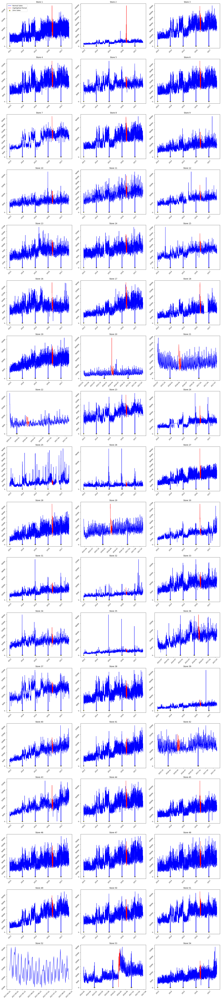

In [ ]:
a = d.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
# Define the start and end of the earthquake period
start_date = pd.to_datetime('2016-04-17')
end_date = pd.to_datetime('2016-05-16')

# Assuming 'a' is your DataFrame and it's already defined

# Convert 'date' column to datetime if not already
a['date'] = pd.to_datetime(a['date'])

# Get the unique store IDs from the DataFrame
store_ids = a['store_nbr'].unique()
# Determine the number of subplot rows needed, with up to 4 plots per row for example
n_rows = len(store_ids) // 3 + (len(store_ids) % 3 > 0)

# Create a figure with subplots
fig, axs = plt.subplots(n_rows, 3, figsize=(20, n_rows*5))  # Adjust figsize as needed

# Flatten the axes array for easy indexing
axs = axs.flatten()

# Loop through each store ID to create a plot in a subplot
for index, store_id in enumerate(store_ids):
    # Filter the DataFrame to only include sales for the current store
    store_data = a[a['store_nbr'] == store_id]

    # Plot data outside the specified range in blue
    normal_data = store_data[(store_data['date'] < start_date) | (store_data['date'] > end_date)]
    axs[index].plot(normal_data['date'], normal_data['sales'], color='blue', label='Normal Sales')

    # Highlight the specified date range in red
    highlight_data = store_data[(store_data['date'] >= start_date) & (store_data['date'] <= end_date)]
    axs[index].plot(highlight_data['date'], highlight_data['sales'], color='red', label='Highlighted Period')

    # Plot zero sales in yellow
    zero_sales_data = store_data[store_data['sales'] == 0]
    axs[index].scatter(zero_sales_data['date'], zero_sales_data['sales'], color='yellow', label='Zero Sales', edgecolor='black')

    axs[index].set_title(f'Store {store_id}')
    axs[index].tick_params(labelrotation=45)  # Rotate date labels for clarity

# Hide any unused subplots (if the number of stores isn't a multiple of 4)
for ax in axs[len(store_ids):]:
    ax.axis('off')

# Adjust layout to prevent overlap
plt.tight_layout()

# Add a legend to the first subplot for clarity, or to each subplot if preferred
axs[0].legend()

# Show the figure
plt.show()

In [ ]:
stores_list = df_zero_sales_filtered['store_nbr'].unique()
print(stores_list)

[ 1 12 14 17 18 24 25 30 43]


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Encoding

In [ ]:
def Encoding(df,train_data,data_store):
    def one_hot_encoder(df, nan_as_category=True):
        original_columns = list(df.columns)
        categorical_columns = df.select_dtypes(["category", "object"]).columns.tolist()
        # categorical_columns = [col for col in df.columns if df[col].dtype == 'object']
        df = pd.get_dummies(df, columns=categorical_columns, dummy_na=nan_as_category, dtype=int)
        new_columns = [c for c in df.columns if c not in original_columns]
        df.columns = df.columns.str.replace(" ", "_")
        return df, df.columns.tolist()

    train_data, train_data_cat = one_hot_encoder(train_data, nan_as_category=False)
    df = pd.merge(df, train_data, how = "left")
    df[train_data_cat] = df[train_data_cat].fillna(0)

    data_store, data_store_cat = one_hot_encoder(data_store, nan_as_category=False)
    df = pd.merge(df, data_store, how = "left")
    df[data_store_cat] = df[data_store_cat].fillna(0)

    df = df.drop(["family","city","state","type"], axis = 1)
    return df

In [ ]:
d=Encoding(d,train_data,data_store)
d.head()

,date,store_nbr,sales,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,...,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E
0,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
1,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
2,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
3,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0
4,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,0,1,0,0,0,0,0,0,1,0


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Merge oil data

In [ ]:
#chose d for train, e for test
def Merge_oil(chose,df):
    if chose=='d':
        p=path+'train.csv'
    elif chose=='e':
        p=path+'test.csv'

    data = pd.read_csv(p)
    oil=pd.read_csv(path+'oil.csv')
    oil.loc[oil['date'] == '2013-01-01', 'dcoilwtico'] = 93.14
    oil = oil.interpolate(method='linear')

    df_oil = pd.merge(data, oil, on='date', how='outer')
    df_oil = df_oil.interpolate(method='ffill', limit=20000)

    df_oil = df_oil[['date', 'dcoilwtico']].drop_duplicates().reset_index(drop=True)
    df_oil['date'] = pd.to_datetime(df_oil['date'])

    df = pd.merge(df, df_oil, on='date', how='left')
    return df

In [ ]:
d=Merge_oil('d',d)
d.head()

,date,store_nbr,sales,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,...,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico
0,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
1,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
2,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
3,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14
4,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,0,0,0,0,0,1,0,93.14


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Time data

In [ ]:
# Time Related Features
def create_date_features(df):
    # Create a dictionary to hold new columns
    new_columns = {
        'month': df.date.dt.month.astype("int8"),
        'day_of_month': df.date.dt.day.astype("int8"),
        'day_of_year': df.date.dt.dayofyear.astype("int16"),
        'week_of_month': ((df.date.apply(lambda d: (d.day-1) // 7 + 1))).astype("int8"),
        'week_of_year': df.date.dt.isocalendar().week.astype("int8"),
        'day_of_week': (df.date.dt.dayofweek + 1).astype("int8"),
        'year': df.date.dt.year.astype("int16"),
    }
    new_columns_df = pd.DataFrame(new_columns, index=df.index)


    # Concatenate the original DataFrame with the new columns
    df = pd.concat([df, new_columns_df], axis=1)

    return df


# Example usage



In [ ]:
d = create_date_features(d)
d.head()

,date,store_nbr,sales,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,...,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year
0,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
1,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
2,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
3,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013
4,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,1,0,93.14,1,1,1,1,1,2,2013


In [ ]:
Check_null(d)

DataFrame does not have null values.


## Feature Engineering

### Time Features

In [ ]:
# Time Related Features
def create_date_features_plus(df):
    # Create a dictionary to hold new columns
    new_columns = {
        "is_wknd": (df.date.dt.weekday // 4).astype("int8"),
        "quarter": df.date.dt.quarter.astype("int8"),
        'is_month_start': df.date.dt.is_month_start.astype("int8"),
        'is_month_end': df.date.dt.is_month_end.astype("int8"),
        'is_quarter_start': df.date.dt.is_quarter_start.astype("int8"),
        'is_quarter_end': df.date.dt.is_quarter_end.astype("int8"),
        'is_year_start': df.date.dt.is_year_start.astype("int8"),
        'is_year_end': df.date.dt.is_year_end.astype("int8"),
        # Season calculation
        "season": np.where(df.date.dt.month.isin([12,1,2]), 0, 1)
    }
    new_columns["season"] = np.where(df.date.dt.month.isin([6,7,8]), 2, new_columns["season"])
    new_columns["season"] = pd.Series(np.where(df.date.dt.month.isin([9, 10, 11]), 3, new_columns["season"])).astype("int8")
    new_columns_df = pd.DataFrame(new_columns, index=df.index)


    # Concatenate the original DataFrame with the new columns
    df = pd.concat([df, new_columns_df], axis=1)

    return df

# Example usage





In [ ]:
d = create_date_features_plus(d)
d.head()

,date,store_nbr,sales,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,...,year,is_wknd,quarter,is_month_start,is_month_end,is_quarter_start,is_quarter_end,is_year_start,is_year_end,season
0,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,2013,0,1,1,0,1,0,1,0,0
1,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,2013,0,1,1,0,1,0,1,0,0
2,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,2013,0,1,1,0,1,0,1,0,0
3,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,2013,0,1,1,0,1,0,1,0,0
4,2013-01-01,1,0.0,0.0,13,NaN,0,0,0,0,...,2013,0,1,1,0,1,0,1,0,0


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Workday feature

In [ ]:
#Workday column
def workday(df):
  df["workday"] = np.where((df.holiday_national_binary == 1) | (df.holiday_local_binary==1) | (df.holiday_regional_binary==1) | (df['day_of_week'].isin([6,7])), 0, 1)
  df["workday"] = pd.Series(np.where(df.IsWorkDay.notnull(), 1, df["workday"])).astype("int8")
  df.drop("IsWorkDay", axis = 1, inplace = True)
  return df

In [ ]:
d=workday(d)

In [ ]:
d.head()

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,...,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year,workday
0,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
1,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
2,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
3,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
4,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0


In [ ]:
Check_null(d)

DataFrame does not have null values.


### Wageday feature

In [ ]:
# Calculate 'wageday'
def wageday(df):
    first_date = df['date'].min()
    df['wageday'] = d['date'].apply(lambda x: ((x - first_date).days) % 15 + 1)
    return df

In [ ]:
d=wageday(d)
d.head()

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,...,quarter,is_month_start,is_month_end,is_quarter_start,is_quarter_end,is_year_start,is_year_end,season,workday,wageday
0,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,1,0,1,0,1,0,0,0,1
1,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,1,0,1,0,1,0,0,0,1
2,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,1,0,1,0,1,0,0,0,1
3,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,1,0,1,0,1,0,0,0,1
4,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,1,1,0,1,0,1,0,0,0,1


In [ ]:
d.drop("IsWorkDay", axis = 1, inplace = True)

In [ ]:
Check_null(d)

DataFrame does not have null values.


### School Feature
https://yfu.org.ec/year-in-ecuador/#:~:text=The%20regular%20school%20calendar%20is,you%20will%20not%20attend%20school.

In [ ]:
def school_feature(df):
  df['school_season'] = np.where(df['month'].isin([3, 4, 8, 9]), 1, 0)
  return df

In [ ]:
d=school_feature(d)

In [ ]:
d.head()

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,...,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,year,school_season
0,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
1,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
2,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
3,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0
4,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,0,93.14,1,1,1,1,1,2,2013,0


In [ ]:
Check_null(d)

DataFrame does not have null values.



### Oil Lag Feature

In [ ]:
def oil_lag_feature(combined_df,df):
    data = combined_df
    oil=pd.read_csv(path+'oil.csv')
    oil.loc[oil['date'] == '2013-01-01', 'dcoilwtico'] = 93.14
    oil = oil.interpolate(method='linear')
    oil['date'] = pd.to_datetime(oil['date'])

    df_oil = pd.merge(data, oil, on='date', how='outer')
    df_oil = df_oil.interpolate(method='ffill', limit=20000)

    df_oil = df_oil[['date', 'dcoilwtico']].drop_duplicates().reset_index(drop=True)


    #compute lags for oil price
    LAGS_OIL = [1,2,3,4,5,6,7, 16,21,28,35, 90, 180, 365]

    #compute lags for oil prices
    df_lag_oil = df_oil.copy()
    df_lag_oil['date'] = pd.to_datetime(df_lag_oil['date'])
    for lag in LAGS_OIL:
        df_lag_oil[f"oil_lag_{lag}"] = df_lag_oil['dcoilwtico'].transform(lambda x: x.shift(lag))

    # Calculate the average value of 'dcoilwtico' for the year 2013
    average_2013 = df_lag_oil[df_lag_oil['date'].dt.year == 2013]['dcoilwtico'].mean()

    # Replace NaN values in all columns except 'date' with the average value
    df_lag_oil.update(df_lag_oil.loc[:, df_lag_oil.columns != 'date'].fillna(average_2013))


    df_lag_oil.drop(['dcoilwtico'], axis='columns', inplace=True)

    df_lag_oil['date'] = pd.to_datetime(df_lag_oil['date'])
    df = pd.merge(df, df_lag_oil, on='date', how='left')
    return df

In [ ]:
d=oil_lag_feature(combined_df,d)

In [ ]:
d.head()

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,...,oil_lag_5,oil_lag_6,oil_lag_7,oil_lag_16,oil_lag_21,oil_lag_28,oil_lag_35,oil_lag_90,oil_lag_180,oil_lag_365
0,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959
1,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959
2,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959
3,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959
4,2013-01-01,1,0.0,0.0,13,0,0,0,0,0,...,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959,97.990959


In [ ]:
Check_null(d)

### Fourier Feature

In [ ]:
from statsmodels.tsa.deterministic import DeterministicProcess
from statsmodels.tsa.deterministic import CalendarFourier
# fourier features
fourier_W = CalendarFourier(freq='W', order=4)

dp_W = DeterministicProcess(index=pd.date_range('2013-01-01', '2017-08-31'),
                          constant=False,
                          order=1,
                          seasonal=False,
                          additional_terms=[fourier_W],
                          drop=True)
dp_W_df = dp_W.in_sample()

In [ ]:
dp_W_df

,trend,"sin(1,freq=W-SUN)","cos(1,freq=W-SUN)","sin(2,freq=W-SUN)","cos(2,freq=W-SUN)","sin(3,freq=W-SUN)","cos(3,freq=W-SUN)"
2013-01-01,1.0,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969
2013-01-02,2.0,0.974928,-0.222521,-0.433884,-0.900969,-0.781831,0.623490
2013-01-03,3.0,0.433884,-0.900969,-0.781831,0.623490,0.974928,-0.222521
2013-01-04,4.0,-0.433884,-0.900969,0.781831,0.623490,-0.974928,-0.222521
2013-01-05,5.0,-0.974928,-0.222521,0.433884,-0.900969,0.781831,0.623490
...,...,...,...,...,...,...,...
2017-08-27,1700.0,-0.781831,0.623490,-0.974928,-0.222521,-0.433884,-0.900969
2017-08-28,1701.0,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
2017-08-29,1702.0,0.781831,0.623490,0.974928,-0.222521,0.433884,-0.900969
2017-08-30,1703.0,0.974928,-0.222521,-0.433884,-0.900969,-0.781831,0.623490


In [ ]:
from statsmodels.tsa.deterministic import DeterministicProcess
from statsmodels.tsa.deterministic import CalendarFourier
# fourier features
fourier_A = CalendarFourier(freq='A', order=10)

dp_A = DeterministicProcess(index=pd.date_range('2013-01-01', '2017-08-31'),
                          constant=False,
                          order=1,
                          seasonal=False,
                          additional_terms=[fourier_A],
                          drop=True)
dp_A_df = dp_A.in_sample()

In [ ]:
dp_A_df

,trend,"sin(1,freq=A-DEC)","cos(1,freq=A-DEC)","sin(2,freq=A-DEC)","cos(2,freq=A-DEC)","sin(3,freq=A-DEC)","cos(3,freq=A-DEC)","sin(4,freq=A-DEC)","cos(4,freq=A-DEC)","sin(5,freq=A-DEC)",...,"sin(6,freq=A-DEC)","cos(6,freq=A-DEC)","sin(7,freq=A-DEC)","cos(7,freq=A-DEC)","sin(8,freq=A-DEC)","cos(8,freq=A-DEC)","sin(9,freq=A-DEC)","cos(9,freq=A-DEC)","sin(10,freq=A-DEC)","cos(10,freq=A-DEC)"
2013-01-01,1.0,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,...,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000,0.000000,1.000000
2013-01-02,2.0,0.017213,0.999852,0.034422,0.999407,0.051620,0.998667,0.068802,0.997630,0.085965,...,0.103102,0.994671,0.120208,0.992749,0.137279,0.990532,0.154309,0.988023,0.171293,0.985220
2013-01-03,3.0,0.034422,0.999407,0.068802,0.997630,0.103102,0.994671,0.137279,0.990532,0.171293,...,0.205104,0.978740,0.238673,0.971100,0.271958,0.962309,0.304921,0.952378,0.337523,0.941317
2013-01-04,4.0,0.051620,0.998667,0.103102,0.994671,0.154309,0.988023,0.205104,0.978740,0.255353,...,0.304921,0.952378,0.353676,0.935368,0.401488,0.915864,0.448229,0.893919,0.493776,0.869589
2013-01-05,5.0,0.068802,0.997630,0.137279,0.990532,0.205104,0.978740,0.271958,0.962309,0.337523,...,0.401488,0.915864,0.463550,0.886071,0.523416,0.852078,0.580800,0.814046,0.635432,0.772157
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2017-08-27,1700.0,-0.816538,-0.577292,0.942761,-0.333469,-0.271958,0.962309,-0.628763,-0.777597,0.997917,...,-0.523416,0.852078,-0.393590,-0.919286,0.977848,0.209315,-0.735417,0.677615,-0.128748,-0.991677
2017-08-28,1701.0,-0.826354,-0.563151,0.930724,-0.365723,-0.221922,0.975065,-0.680773,-0.732494,0.988678,...,-0.432776,0.901502,-0.501242,-0.865307,0.997325,0.073095,-0.622047,0.782980,-0.296713,-0.954967
2017-08-29,1702.0,-0.835925,-0.548843,0.917584,-0.397543,-0.171293,0.985220,-0.729558,-0.683919,0.972118,...,-0.337523,0.941317,-0.601624,-0.798779,0.997917,-0.064508,-0.493776,0.869589,-0.455907,-0.890028
2017-08-30,1703.0,-0.845249,-0.534373,0.903356,-0.428892,-0.120208,0.992749,-0.774884,-0.632103,0.948362,...,-0.238673,0.971100,-0.693281,-0.720667,0.979614,-0.200891,-0.353676,0.935368,-0.601624,-0.798779


In [ ]:
#reset 'date' to a column for merging
# Merge the DataFrames on the 'date' column
def merge_dfs(df1, df2):
  df2 = df2.reset_index().rename(columns={'index': 'date'})
  df2['date'] = pd.to_datetime(df2['date'])
  merged_df = pd.merge(df1, df2, on='date', how='left')
  return merged_df

In [ ]:
d=merge_dfs(d,dp_A_df)
d=merge_dfs(d,dp_W_df)
d.drop(['trend_y'], axis='columns', inplace=True)

In [ ]:
d

,date,store_nbr,sales,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,events_Terremoto_Manabi1,events_Terremoto_Manabi10,events_Terremoto_Manabi11,events_Terremoto_Manabi12,events_Terremoto_Manabi13,events_Terremoto_Manabi14,events_Terremoto_Manabi15,events_Terremoto_Manabi16,events_Terremoto_Manabi17,events_Terremoto_Manabi18,events_Terremoto_Manabi19,events_Terremoto_Manabi2,events_Terremoto_Manabi20,events_Terremoto_Manabi21,events_Terremoto_Manabi22,events_Terremoto_Manabi23,events_Terremoto_Manabi24,events_Terremoto_Manabi25,events_Terremoto_Manabi26,events_Terremoto_Manabi27,events_Terremoto_Manabi28,events_Terremoto_Manabi29,events_Terremoto_Manabi3,events_Terremoto_Manabi30,events_Terremoto_Manabi4,events_Terremoto_Manabi5,events_Terremoto_Manabi6,events_Terremoto_Manabi7,events_Terremoto_Manabi8,events_Terremoto_Manabi9,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre1,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Navidad1,holiday_national_Navidad2,holiday_national_Navidad3,holiday_national_Navidad4,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Primer_dia_del_ano1,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Guayaquil1,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Quito1,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,family_AUTOMOTIVE,family_BABY_CARE,family_BEAUTY,family_BEVERAGES,family_BOOKS,family_BREAD/BAKERY,family_CELEBRATION,family_CLEANING,family_DAIRY,family_DELI,family_EGGS,family_FROZEN_FOODS,family_GROCERY_I,family_GROCERY_II,family_HARDWARE,family_HOME_AND_KITCHEN_I,family_HOME_AND_KITCHEN_II,family_HOME_APPLIANCES,family_HOME_CARE,family_LADIESWEAR,family_LAWN_AND_GARDEN,family_LINGERIE,"family_LIQUOR,WINE,BEER",family_MAGAZINES,family_MEATS,family_PERSONAL_CARE,family_PET_SUPPLIES,family_PLAYERS_AND_ELECTRONICS,family_POULTRY,family_PREPARED_FOODS,family_PRODUCE,family_SCHOOL_AND_OFFICE_SUPPLIES,family_SEAFOOD,city_Ambato,city_Babahoyo,city_Cayambe,city_Cuenca,city_Daule,city_El_Carmen,city_Esmeraldas,city_Guaranda,city_Guayaquil,city_Ibarra,city_Latacunga,city_Libertad,city_Loja,city_Machala,city_Manta,city_Playas,city_Puyo,city_Quevedo,city_Quito,city_Riobamba,city_Salinas,city_Santo_Domingo,state_Azuay,state_Bolivar,state_Chimborazo,state_Cotopaxi,state_El_Oro,state_Esmeraldas,state_Guayas,state_Imbabura,state_Loja,state_Los_Rios,state_Manabi,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,y

In [ ]:
Check_null(d)

DataFrame does not have null values.


## Train test split

In [ ]:
train_start_date = '2013-01-01'
train_end_date = '2017-07-31'
valid_start_date = '2017-08-01'
valid_end_date = '2017-08-15'

X_train = d[(d['date'] >= train_start_date) & (d['date'] <= train_end_date)]
X_valid = d[(d['date'] >= valid_start_date) & (d['date'] <= valid_end_date)]
y_train = pd.DataFrame(X_train.sales,columns = ['sales'], index = X_train.index)
y_valid = pd.DataFrame(X_valid.sales,columns = ['sales'], index = X_valid.index)
# Realese RAM
#del d

In [ ]:
date_df = pd.DataFrame()
date_df['date'] = X_valid['date']

In [ ]:
def drop_columns (df):
    df.drop(['date'], axis='columns', inplace=True)
    df.drop(['sales'], axis='columns', inplace=True)
    return df

X_train = drop_columns(X_train)
X_valid = drop_columns(X_valid)

In [ ]:
X_train.shape

(10323494, 227)

## Modelling

### XGBoost

In [ ]:
import xgboost as xgb

In [ ]:
model_XGB = xgb.XGBRegressor(objective='reg:tweedie')
model_XGB.fit(X_train, y_train, verbose=False)
predictions = model_XGB.predict(X_valid)

In [ ]:
predictions_xgb = pd.DataFrame(data=predictions, columns=['sales'], index=y_valid.index)
predictions_xgb = pd.merge(predictions_xgb, y_valid, on=predictions_xgb.index, suffixes=('_predict', '_true'))
predictions_xgb = predictions_xgb.set_index('key_0')
predictions_xgb.head()

In [ ]:
print(root_mean_squared_log_error(predictions_xgb['sales_true'], predictions_xgb['sales_predict']))

#### Optimize hyperparameter


In [ ]:
def objective(trial):
    params = {
        "objective": "reg:tweedie",
        "n_estimators": 1000,
        "verbosity": 0,
        "learning_rate": trial.suggest_float("learning_rate", 1e-3, 0.1, log=True),
        "max_depth": trial.suggest_int("max_depth", 1, 10),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bytree": trial.suggest_float("colsample_bytree", 0.05, 1.0),
        "min_child_weight": trial.suggest_int("min_child_weight", 1, 20),
    }

    model = xgb.XGBRegressor(**params,enable_categorical=True)
    model.fit(X_train, y_train, verbose=False)
    predictions = model.predict(X_valid)
    rmsle = root_mean_squared_log_error(predictions, y_valid)
    return rmsle

In [ ]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=20)

[I 2024-03-16 11:09:07,001] A new study created in memory with name: no-name-e0aeee05-3014-4a37-9af2-36d5c9b8575f
[I 2024-03-16 11:12:04,263] Trial 0 finished with value: 2.7397701740264893 and parameters: {'learning_rate': 0.002812435401192461, 'max_depth': 1, 'subsample': 0.9748634392711799, 'colsample_bytree': 0.8943266864556033, 'min_child_weight': 13}. Best is trial 0 with value: 2.7397701740264893.
[I 2024-03-16 11:16:12,403] Trial 1 finished with value: 0.4770890772342682 and parameters: {'learning_rate': 0.08493763686811855, 'max_depth': 5, 'subsample': 0.15817751628676086, 'colsample_bytree': 0.1921524289315374, 'min_child_weight': 9}. Best is trial 1 with value: 0.4770890772342682.
[I 2024-03-16 11:21:59,491] Trial 2 finished with value: 0.4507378339767456 and parameters: {'learning_rate': 0.06414153499343576, 'max_depth': 9, 'subsample': 0.7766032109624911, 'colsample_bytree': 0.17810892967386738, 'min_child_weight': 17}. Best is trial 2 with value: 0.4507378339767456.
[I 20

In [ ]:
print('Best hyperparameters:', study.best_params)
print('Best RMSLE:', study.best_value)

Best hyperparameters: {'learning_rate': 0.025048799341379026, 'max_depth': 10, 'subsample': 0.4475851750955303, 'colsample_bytree': 0.8145724734612336, 'min_child_weight': 15}
Best RMSLE: 0.4296581447124481


In [ ]:
plot_optimization_history(study)

In [ ]:
plot_param_importances(study)

In [ ]:
best_param = {
  "objective": "reg:tweedie",
  "n_estimators": 1000,
  "verbosity": 0,
  'learning_rate': 0.025048799341379026,
  'max_depth': 10,
  'subsample': 0.4475851750955303,
  'colsample_bytree': 0.8145724734612336,
  'min_child_weight': 15}

In [ ]:
xgb_reg = xgb.XGBRegressor(**best_param)
xgb_reg.fit(X_train, y_train)
predictions = xgb_reg.predict(X_valid)

In [ ]:
predictions_xgb_tune = pd.DataFrame(data=predictions, columns=['sales'], index=y_valid.index)
predictions_xgb_tune = pd.merge(predictions_xgb_tune, y_valid, on=predictions_xgb_tune.index, suffixes=('_predict_tune', '_true'))
predictions_xgb_tune = predictions_xgb_tune.set_index('key_0')
predictions_xgb_tune.head()

,sales_predict_tune,sales_true
key_0,,
55044,4.984063,5.0
55045,0.012478,0.0
55046,4.139695,4.0
55047,2617.658936,2627.0
55048,0.072940,0.0


In [ ]:
print(root_mean_squared_log_error(predictions_xgb_tune['sales_true'], predictions_xgb_tune['sales_predict_tune']))

0.42965814


### LGBM

In [ ]:
from lightgbm import LGBMRegressor
LGBMR_param={
        'objective':"tweedie"}
#https://lightgbm.readthedocs.io/en/latest/Parameters.html#objective

In [ ]:
X_train_str=X_train.copy(deep=True)
X_valid_str=X_valid.copy(deep=True)

In [ ]:
import re
plus_char = r'[+]'
minus_char = r'[-]'
# Use pandas' rename with a regex directly

X_train_str.columns = X_train_str.columns.str.replace(plus_char, 'plus', regex=True)
X_train_str.columns = X_train_str.columns.str.replace(minus_char, 'minus', regex=True)

X_valid_str.columns = X_valid_str.columns.str.replace(plus_char, 'plus', regex=True)
X_valid_str.columns = X_valid_str.columns.str.replace(minus_char, 'minus', regex=True)

X_train_str = X_train_str.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))
X_valid_str = X_valid_str.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
model_LGBM =  LGBMRegressor(**LGBMR_param)
model_LGBM.fit(X_train_str, y_train)
predictions = model_LGBM.predict(X_valid_str)

In [ ]:
predictions_lgbm = pd.DataFrame(data=predictions, columns=['sales'], index=y_valid.index)
predictions_lgbm = pd.merge(predictions_lgbm, y_valid, on=predictions_lgbm.index, suffixes=('_predict', '_true'))
predictions_lgbm = predictions_lgbm.set_index('key_0')
predictions_lgbm.head()

In [ ]:
 print(root_mean_squared_log_error(predictions_lgbm['sales_true'], predictions_lgbm['sales_predict']))

#### Optimize hyperparameter


In [ ]:
def objective(trial):
    params = {
        'objective':"tweedie",
        'metric': 'rmse',
        'random_state': 48,
        'n_estimators': 20000,
        'colsample_bytree': trial.suggest_categorical('colsample_bytree', [0.3,0.4,0.5,0.6,0.7,0.8,0.9, 1.0]),
        'subsample': trial.suggest_categorical('subsample', [0.4,0.5,0.6,0.7,0.8,1.0]),
        'learning_rate': trial.suggest_categorical('learning_rate', [0.006,0.008,0.01,0.014,0.017,0.02]),
        'max_depth': trial.suggest_categorical('max_depth', [10,20,100]),
        'num_leaves' : trial.suggest_int('num_leaves', 1, 1000),
        'min_child_samples': trial.suggest_int('min_child_samples', 1, 300),
        'cat_smooth' : trial.suggest_int('min_data_per_groups', 1, 100)
    }

    model_LGBM =  LGBMRegressor(**params)
    model_LGBM.fit(X_train_str, y_train)
    predictions = model_LGBM.predict(X_valid_str)
    rmsle = root_mean_squared_log_error(predictions, y_valid)
    return rmsle


In [ ]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=5)

[I 2024-03-16 13:09:08,384] A new study created in memory with name: no-name-1f38e99e-7b23-4800-bba9-33804db7f48b


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.296169 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4727
[LightGBM] [Info] Number of data points in the train set: 2742234, number of used features: 161
[LightGBM] [Info] Start training from score 5.958394


[I 2024-03-16 13:40:27,308] Trial 0 finished with value: 0.40354573728604093 and parameters: {'colsample_bytree': 0.6, 'subsample': 0.4, 'learning_rate': 0.014, 'max_depth': 100, 'num_leaves': 203, 'min_child_samples': 234, 'min_data_per_groups': 97}. Best is trial 0 with value: 0.40354573728604093.


Kết quả truyền trực tuyến bị cắt bớt đến 5000 dòng cuối.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

[I 2024-03-16 14:16:22,982] Trial 1 finished with value: 0.4043561032634381 and parameters: {'colsample_bytree': 0.8, 'subsample': 0.4, 'learning_rate': 0.02, 'max_depth': 10, 'num_leaves': 358, 'min_child_samples': 74, 'min_data_per_groups': 26}. Best is trial 0 with value: 0.40354573728604093.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.282440 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4757
[LightGBM] [Info] Number of data points in the train set: 2742234, number of used features: 176
[LightGBM] [Info] Start training from score 5.958394


[I 2024-03-16 14:32:43,978] Trial 2 finished with value: 0.7543752467839413 and parameters: {'colsample_bytree': 0.7, 'subsample': 0.5, 'learning_rate': 0.01, 'max_depth': 10, 'num_leaves': 2, 'min_child_samples': 32, 'min_data_per_groups': 45}. Best is trial 0 with value: 0.40354573728604093.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.282469 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4751
[LightGBM] [Info] Number of data points in the train set: 2742234, number of used features: 173
[LightGBM] [Info] Start training from score 5.958394


[I 2024-03-16 15:11:21,097] Trial 3 finished with value: 0.39694115661416046 and parameters: {'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.014, 'max_depth': 100, 'num_leaves': 576, 'min_child_samples': 99, 'min_data_per_groups': 99}. Best is trial 3 with value: 0.39694115661416046.


[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.229395 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4749
[LightGBM] [Info] Number of data points in the train set: 2742234, number of used features: 172
[LightGBM] [Info] Start training from score 5.958394


[I 2024-03-16 15:52:38,353] Trial 4 finished with value: 0.40771029217690713 and parameters: {'colsample_bytree': 0.4, 'subsample': 0.7, 'learning_rate': 0.017, 'max_depth': 100, 'num_leaves': 322, 'min_child_samples': 116, 'min_data_per_groups': 52}. Best is trial 3 with value: 0.39694115661416046.


In [ ]:
print('Best hyperparameters:', study.best_params)
print('Best RMSLE:', study.best_value)

Best hyperparameters: {'colsample_bytree': 0.7, 'subsample': 0.6, 'learning_rate': 0.014, 'max_depth': 100, 'num_leaves': 576, 'min_child_samples': 99, 'min_data_per_groups': 99}
Best RMSLE: 0.39694115661416046


In [ ]:
plot_optimization_history(study)

In [ ]:
plot_param_importances(study)

In [ ]:
best_param = {
    'objective':"tweedie",
    'metric': 'rmse',
    'random_state': 48,
    'n_estimators': 20000,
    'colsample_bytree': 0.7,
    'subsample': 0.6,
    'learning_rate': 0.014,
    'max_depth': 100,
    'num_leaves': 576,
    'min_child_samples': 99,
    'min_data_per_groups': 99}

In [ ]:
lgbm_reg = LGBMRegressor(**best_param)
lgbm_reg.fit(X_train_str, y_train)
predictions = lgbm_reg.predict(X_valid_str)

[LightGBM] [Warning] Unknown parameter: min_data_per_groups
[LightGBM] [Warning] Unknown parameter: min_data_per_groups
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.301493 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 4751
[LightGBM] [Info] Number of data points in the train set: 2742234, number of used features: 173
[LightGBM] [Info] Start training from score 5.958394
[LightGBM] [Warning] Unknown parameter: min_data_per_groups


In [ ]:
predictions_lgbm_tune = pd.DataFrame(data=predictions, columns=['sales'], index=y_valid.index)
predictions_lgbm_tune = pd.merge(predictions_lgbm_tune, y_valid, on=predictions_lgbm_tune.index, suffixes=('_predict_tune', '_true'))
predictions_lgbm_tune = predictions_lgbm_tune.set_index('key_0')
predictions_lgbm_tune.head()

,sales_predict_tune,sales_true
key_0,,
55044,5.420686,5.0
55045,0.000999,0.0
55046,3.427109,4.0
55047,2553.354152,2627.0
55048,0.048556,0.0


In [ ]:
print(root_mean_squared_log_error(predictions_lgbm_tune['sales_true'], predictions_lgbm_tune['sales_predict_tune']))

0.39694956968686124


### CatBoost

In [ ]:
!pip install catboost
from catboost import CatBoostRegressor

In [ ]:
#https://github.com/catboost/tutorials/blob/master/regression/tweedie.ipynb
params={
    'loss_function':'Tweedie:variance_power=1.9',
}

In [ ]:
model_CBR =  CatBoostRegressor(**params)
model_CBR.fit(X_train, y_train)
predictions = model_CBR.predict(X_valid)

0:	learn: 121.5710250	total: 633ms	remaining: 10m 32s
1:	learn: 118.3357709	total: 1.22s	remaining: 10m 7s
2:	learn: 115.2029693	total: 1.78s	remaining: 9m 51s
3:	learn: 112.1638182	total: 2.33s	remaining: 9m 41s
4:	learn: 109.2157058	total: 2.9s	remaining: 9m 36s
5:	learn: 106.3556292	total: 3.46s	remaining: 9m 34s
6:	learn: 103.5811379	total: 4.02s	remaining: 9m 30s
7:	learn: 100.8897007	total: 4.59s	remaining: 9m 29s
8:	learn: 98.2788608	total: 5.15s	remaining: 9m 26s
9:	learn: 95.7402725	total: 5.72s	remaining: 9m 25s
10:	learn: 93.2835257	total: 6.38s	remaining: 9m 33s
11:	learn: 90.9004324	total: 7.04s	remaining: 9m 39s
12:	learn: 88.5888131	total: 7.71s	remaining: 9m 45s
13:	learn: 86.3465526	total: 8.38s	remaining: 9m 50s
14:	learn: 84.1715979	total: 9.03s	remaining: 9m 52s
15:	learn: 82.0619567	total: 9.61s	remaining: 9m 50s
16:	learn: 80.0159107	total: 10.2s	remaining: 9m 48s
17:	learn: 78.0311509	total: 10.7s	remaining: 9m 46s
18:	learn: 76.1060727	total: 11.3s	remaining: 9m

In [ ]:
predictions_cbr = pd.DataFrame(data=predictions, columns=['sales'], index=y_valid.index)
predictions_cbr = pd.merge(predictions_cbr, y_valid, on=predictions_cbr.index, suffixes=('_predict', '_true'))
predictions_cbr = predictions_cbr.set_index('key_0')
predictions_cbr.head()

,sales_predict,sales_true
key_0,,
182539,6.141068,5.0
182540,2.681248,5.0
182541,0.129282,0.0
182542,0.051423,0.0
182543,1.288320,0.0


In [ ]:
print(root_mean_squared_log_error(predictions_cbr['sales_true'], predictions_cbr['sales_predict']))

0.7285795231676707


#### Optimize hyperparameter

In [ ]:
def objective(trial):
    params = {
        'loss_function':'Tweedie:variance_power=1.9',
        "iterations": 1000,
        "learning_rate": trial.suggest_float("learning_rate", 1e-3, 0.1, log=True),
        "depth": trial.suggest_int("depth", 1, 10),
        "subsample": trial.suggest_float("subsample", 0.05, 1.0),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.05, 1.0),
        "min_data_in_leaf": trial.suggest_int("min_data_in_leaf", 1, 100),
    }

    model_CBR =  CatBoostRegressor(**params, silent=True)
    model_CBR.fit(X_train, y_train)
    predictions = model_CBR.predict(X_valid)
    rmsle = root_mean_squared_log_error(predictions, y_valid)
    return rmsle

In [ ]:
study = optuna.create_study(direction="minimize")
study.optimize(objective, n_trials=20)

[I 2024-03-16 15:52:38,578] A new study created in memory with name: no-name-b5c389c7-a94f-4103-b994-3031aca3e826
[I 2024-03-16 15:54:59,597] Trial 0 finished with value: 0.47259223950112306 and parameters: {'learning_rate': 0.0835554516522272, 'depth': 8, 'subsample': 0.28030394589606805, 'colsample_bylevel': 0.296548391112115, 'min_data_in_leaf': 99}. Best is trial 0 with value: 0.47259223950112306.
[I 2024-03-16 15:57:12,609] Trial 1 finished with value: 3.3243264157371053 and parameters: {'learning_rate': 0.0010875397694029693, 'depth': 5, 'subsample': 0.46936917486941604, 'colsample_bylevel': 0.9893818503905863, 'min_data_in_leaf': 48}. Best is trial 0 with value: 0.47259223950112306.
[I 2024-03-16 15:59:37,532] Trial 2 finished with value: 3.371669473907627 and parameters: {'learning_rate': 0.0010020152321896399, 'depth': 7, 'subsample': 0.37623069302920037, 'colsample_bylevel': 0.2689336403794161, 'min_data_in_leaf': 72}. Best is trial 0 with value: 0.47259223950112306.
[I 2024-

In [ ]:
print('Best hyperparameters:', study.best_params)
print('Best RMSLE:', study.best_value)

Best hyperparameters: {'learning_rate': 0.08870775803799763, 'depth': 10, 'subsample': 0.0795190840929545, 'colsample_bylevel': 0.3740394861699305, 'min_data_in_leaf': 98}
Best RMSLE: 0.45293497082957246


In [ ]:
plot_optimization_history(study)

In [ ]:
plot_param_importances(study)

In [ ]:
best_param = {
  'loss_function':'Tweedie:variance_power=1.9',
  'iterations': 1000,
  'learning_rate': 0.08870775803799763,
  'depth': 10,
  'subsample': 0.0795190840929545,
  'colsample_bylevel': 0.3740394861699305,
  'min_data_in_leaf': 98}

In [ ]:
model_CBR =  CatBoostRegressor(**best_param, silent=True)
model_CBR.fit(X_train, y_train)
predictions = model_CBR.predict(X_valid)

In [ ]:
predictions_cbr_tune = pd.DataFrame(data=predictions, columns=['sales'], index=y_valid.index)
predictions_cbr_tune = pd.merge(predictions_cbr_tune, y_valid, on=predictions_cbr_tune.index, suffixes=('_predict_tune', '_true'))
predictions_cbr_tune = predictions_cbr_tune.set_index('key_0')
predictions_cbr_tune.head()

,sales_predict_tune,sales_true
key_0,,
55044,4.717817,5.0
55045,0.013492,0.0
55046,4.392851,4.0
55047,2651.712588,2627.0
55048,0.085325,0.0


In [ ]:
print(root_mean_squared_log_error(predictions_cbr_tune['sales_true'], predictions_cbr_tune['sales_predict_tune']))

0.45293497082957246


### Ensemble Vote soft

In [ ]:
# Combine the predictions from all models
combined_df = predictions_xgb_tune[['sales_true']].copy()
combined_df['ensemble_mean'] = (
    predictions_xgb_tune['sales_predict_tune'] +
    predictions_lgbm_tune['sales_predict_tune'] +
    predictions_cbr_tune['sales_predict_tune']
) / 3

In [ ]:
combined_df

,sales_true,ensemble_mean
key_0,,
55044,5.000000,5.040855
55045,0.000000,0.008990
55046,4.000000,3.986552
55047,2627.000000,2607.575225
55048,0.000000,0.068940
...,...,...
2768959,397.339996,411.654701
2768960,104.417999,136.111341
2768961,3803.367920,3665.060324


In [ ]:
print(root_mean_squared_log_error(combined_df['sales_true'], combined_df['ensemble_mean']))

0.41656702289834346


### Plot model performance

Plot 3 model before tuning


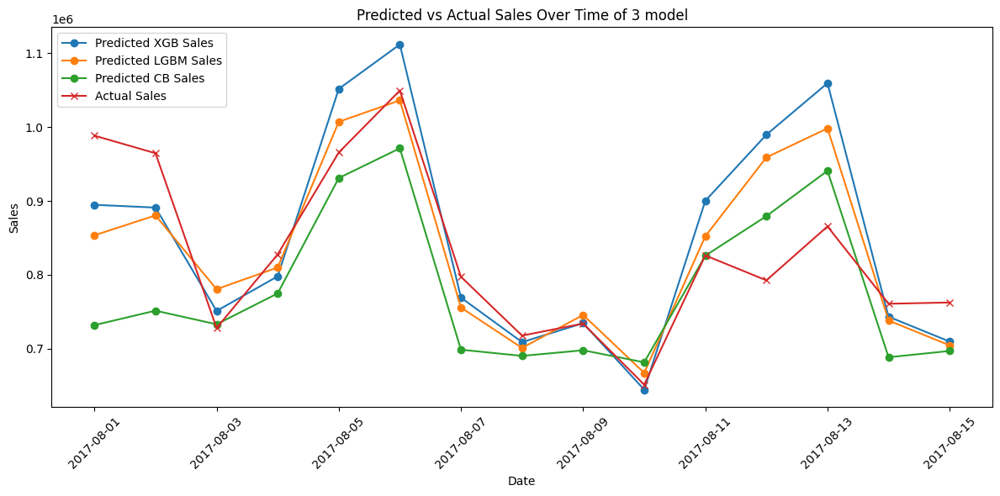

In [ ]:
predictions_xgb_plot = predictions_xgb.merge(date_df['date'], left_on='key_0', right_index=True)
predictions_xgb_plot = predictions_xgb_plot.groupby('date').agg({
    'sales_predict': 'sum',
    'sales_true': 'sum'
}).reset_index()

predictions_lgbm_plot = predictions_lgbm.merge(date_df['date'], left_on='key_0', right_index=True)
predictions_lgbm_plot = predictions_lgbm_plot.groupby('date').agg({
    'sales_predict': 'sum',
    'sales_true': 'sum'
}).reset_index()

predictions_cbr_plot = predictions_cbr.merge(date_df['date'], left_on='key_0', right_index=True)
predictions_cbr_plot = predictions_cbr_plot.groupby('date').agg({
    'sales_predict': 'sum',
    'sales_true': 'sum'
}).reset_index()

# Plotting
plt.figure(figsize=(12, 6))
plt.plot(predictions_xgb_plot['date'], predictions_xgb_plot['sales_predict'], label='Predicted XGB Sales', marker='o')
plt.plot(predictions_lgbm_plot['date'], predictions_lgbm_plot['sales_predict'], label='Predicted LGBM Sales', marker='o')
plt.plot(predictions_cbr_plot['date'], predictions_cbr_plot['sales_predict'], label='Predicted CB Sales', marker='o')

plt.plot(predictions_xgb_plot['date'], predictions_xgb_plot['sales_true'], label='Actual Sales', marker='x')

plt.title('Predicted vs Actual Sales Over Time of 3 model')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend()
plt.xticks(rotation=45)  # Rotate date labels for better readability

plt.tight_layout()
plt.show()

Plot 3 model after tuning and Stacking model

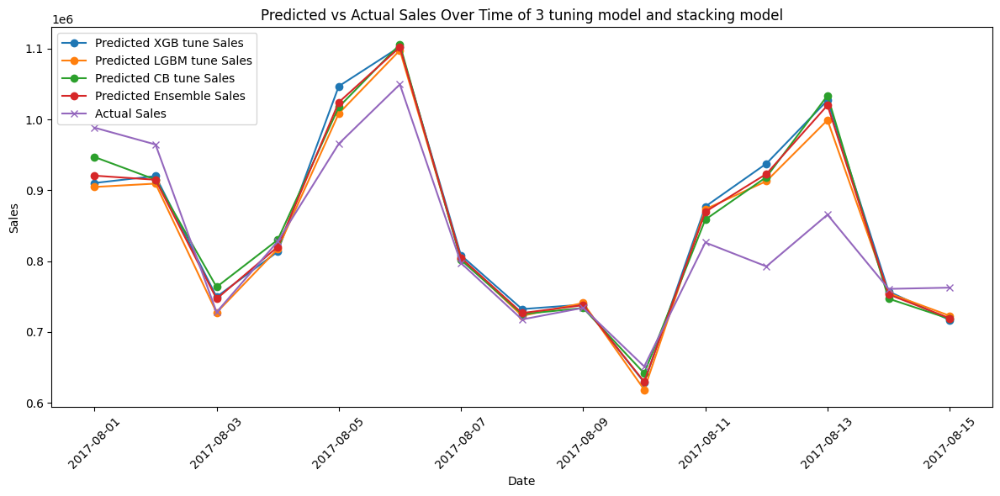

In [ ]:
predictions_xgb_plot = predictions_xgb_tune.merge(date_df['date'], left_on='key_0', right_index=True)
predictions_xgb_plot = predictions_xgb_plot.groupby('date').agg({
    'sales_predict_tune': 'sum',
    'sales_true': 'sum'
}).reset_index()

predictions_lgbm_plot = predictions_lgbm_tune.merge(date_df['date'], left_on='key_0', right_index=True)
predictions_lgbm_plot = predictions_lgbm_plot.groupby('date').agg({
    'sales_predict_tune': 'sum',
    'sales_true': 'sum'
}).reset_index()

predictions_cbr_plot = predictions_cbr_tune.merge(date_df['date'], left_on='key_0', right_index=True)
predictions_cbr_plot = predictions_cbr_plot.groupby('date').agg({
    'sales_predict_tune': 'sum',
    'sales_true': 'sum'
}).reset_index()

combined_df_plot = combined_df.merge(date_df['date'], left_on='key_0', right_index=True)
combined_df_plot = combined_df_plot.groupby('date').agg({
    'ensemble_mean': 'sum',
    'sales_true': 'sum'
}).reset_index()
# Plotting
plt.figure(figsize=(12, 6))
plt.plot(predictions_xgb_plot['date'], predictions_xgb_plot['sales_predict_tune'], label='Predicted XGB tune Sales', marker='o')
plt.plot(predictions_lgbm_plot['date'], predictions_lgbm_plot['sales_predict_tune'], label='Predicted LGBM tune Sales', marker='o')
plt.plot(predictions_cbr_plot['date'], predictions_cbr_plot['sales_predict_tune'], label='Predicted CB tune Sales', marker='o')
plt.plot(combined_df_plot['date'], combined_df_plot['ensemble_mean'], label='Predicted Ensemble Sales', marker='o')

plt.plot(predictions_xgb_plot['date'], predictions_xgb_plot['sales_true'], label='Actual Sales', marker='x')

plt.title('Predicted vs Actual Sales Over Time of 3 tuning model and stacking model')
plt.xlabel('Date')
plt.ylabel('Sales')
plt.legend()
plt.xticks(rotation=45)  # Rotate date labels for better readability

plt.tight_layout()
plt.show()

### Feature Importance

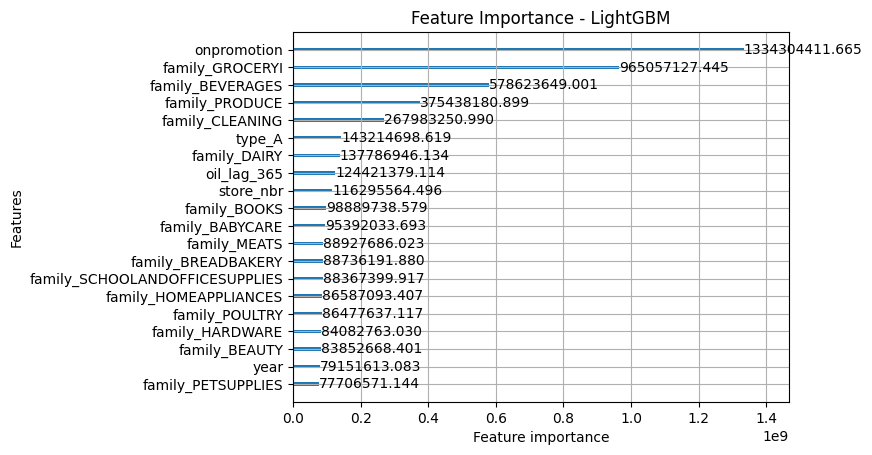

In [ ]:
import lightgbm as lgb

lgb.plot_importance(lgbm_reg, max_num_features=20, importance_type='gain')
plt.title('Feature Importance - LightGBM')
plt.show()

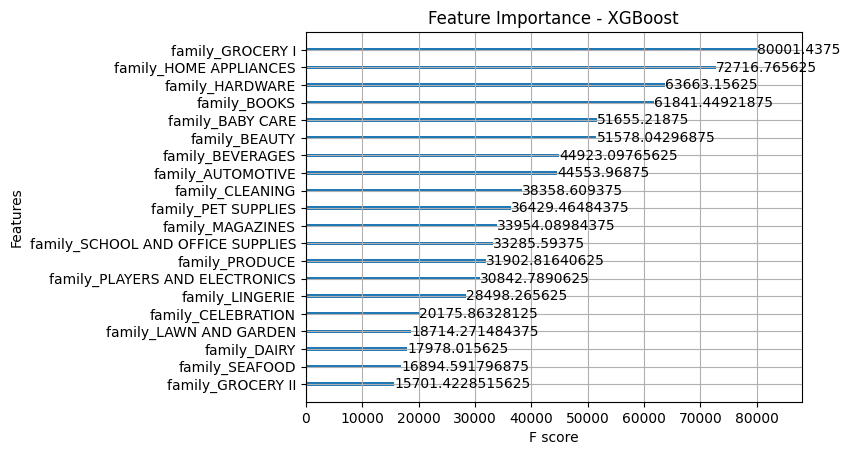

In [ ]:
xgb.plot_importance(xgb_reg, max_num_features=20, importance_type='gain')
plt.title('Feature Importance - XGBoost')
plt.show()

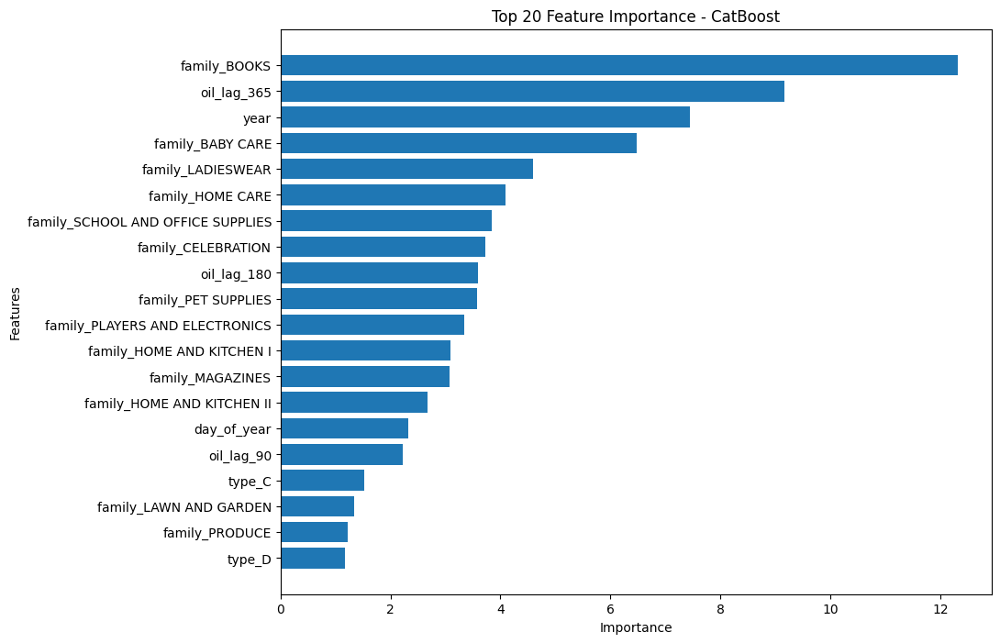

In [ ]:
feature_importances = model_CBR.get_feature_importance()

# Assuming X_train is your dataset and has column names
feature_names = np.array(X_train.columns)

# Sort the features by importance and select the top 20
sorted_indices = np.argsort(feature_importances)[-20:]  # Get indices of top 20 features
top_feature_names = feature_names[sorted_indices]
top_feature_importances = feature_importances[sorted_indices]

# Plotting the top 20 features
plt.figure(figsize=(10, 8))
plt.barh(range(20), top_feature_importances, tick_label=top_feature_names)
plt.xlabel('Importance')
plt.ylabel('Features')
plt.title('Top 20 Feature Importance - CatBoost')
plt.show()

### Test data

In [ ]:
e = Merge_data(combined_df,data_holi,data_store,'test')
e.head()

,date,store_nbr,family,onpromotion,city,state,type,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,events_Terremoto_Manabi1,events_Terremoto_Manabi10,events_Terremoto_Manabi11,events_Terremoto_Manabi12,events_Terremoto_Manabi13,events_Terremoto_Manabi14,events_Terremoto_Manabi15,events_Terremoto_Manabi16,events_Terremoto_Manabi17,events_Terremoto_Manabi18,events_Terremoto_Manabi19,events_Terremoto_Manabi2,events_Terremoto_Manabi20,events_Terremoto_Manabi21,events_Terremoto_Manabi22,events_Terremoto_Manabi23,events_Terremoto_Manabi24,events_Terremoto_Manabi25,events_Terremoto_Manabi26,events_Terremoto_Manabi27,events_Terremoto_Manabi28,events_Terremoto_Manabi29,events_Terremoto_Manabi3,events_Terremoto_Manabi30,events_Terremoto_Manabi4,events_Terremoto_Manabi5,events_Terremoto_Manabi6,events_Terremoto_Manabi7,events_Terremoto_Manabi8,events_Terremoto_Manabi9,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre1,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Navidad1,holiday_national_Navidad2,holiday_national_Navidad3,holiday_national_Navidad4,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Primer_dia_del_ano1,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Guayaquil1,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Quito1,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga
55605,2017-08-16,1,AUTOMOTIVE,0.0,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
55606,2017-08-16,1,BABY CARE,0.0,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
55607,2017-08-16,1,BEAUTY,2.0,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
55608,2017-08-16,1,BEVERAGES,20.0,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
55609,2017-08-16,1,BOOKS,0.0,Quito,Pichincha,D,13,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [ ]:
for column in e.columns:
    print(column)

store_nbr
onpromotion
cluster
events_Black_Friday
events_Cyber_Monday
events_Dia_de_la_Madre
events_Futbol
events_Terremoto_Manabi
events_Terremoto_Manabi1
events_Terremoto_Manabi10
events_Terremoto_Manabi11
events_Terremoto_Manabi12
events_Terremoto_Manabi13
events_Terremoto_Manabi14
events_Terremoto_Manabi15
events_Terremoto_Manabi16
events_Terremoto_Manabi17
events_Terremoto_Manabi18
events_Terremoto_Manabi19
events_Terremoto_Manabi2
events_Terremoto_Manabi20
events_Terremoto_Manabi21
events_Terremoto_Manabi22
events_Terremoto_Manabi23
events_Terremoto_Manabi24
events_Terremoto_Manabi25
events_Terremoto_Manabi26
events_Terremoto_Manabi27
events_Terremoto_Manabi28
events_Terremoto_Manabi29
events_Terremoto_Manabi3
events_Terremoto_Manabi30
events_Terremoto_Manabi4
events_Terremoto_Manabi5
events_Terremoto_Manabi6
events_Terremoto_Manabi7
events_Terremoto_Manabi8
events_Terremoto_Manabi9
holiday_national_binary
holiday_local_binary
holiday_regional_binary
national_independence
local_c

In [ ]:
e=Encoding(e,train_data,data_store)
e.head()

,date,store_nbr,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,events_Terremoto_Manabi1,events_Terremoto_Manabi10,events_Terremoto_Manabi11,events_Terremoto_Manabi12,events_Terremoto_Manabi13,events_Terremoto_Manabi14,events_Terremoto_Manabi15,events_Terremoto_Manabi16,events_Terremoto_Manabi17,events_Terremoto_Manabi18,events_Terremoto_Manabi19,events_Terremoto_Manabi2,events_Terremoto_Manabi20,events_Terremoto_Manabi21,events_Terremoto_Manabi22,events_Terremoto_Manabi23,events_Terremoto_Manabi24,events_Terremoto_Manabi25,events_Terremoto_Manabi26,events_Terremoto_Manabi27,events_Terremoto_Manabi28,events_Terremoto_Manabi29,events_Terremoto_Manabi3,events_Terremoto_Manabi30,events_Terremoto_Manabi4,events_Terremoto_Manabi5,events_Terremoto_Manabi6,events_Terremoto_Manabi7,events_Terremoto_Manabi8,events_Terremoto_Manabi9,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre1,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Navidad1,holiday_national_Navidad2,holiday_national_Navidad3,holiday_national_Navidad4,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Primer_dia_del_ano1,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Guayaquil1,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Quito1,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,sales,family_AUTOMOTIVE,family_BABY_CARE,family_BEAUTY,family_BEVERAGES,family_BOOKS,family_BREAD/BAKERY,family_CELEBRATION,family_CLEANING,family_DAIRY,family_DELI,family_EGGS,family_FROZEN_FOODS,family_GROCERY_I,family_GROCERY_II,family_HARDWARE,family_HOME_AND_KITCHEN_I,family_HOME_AND_KITCHEN_II,family_HOME_APPLIANCES,family_HOME_CARE,family_LADIESWEAR,family_LAWN_AND_GARDEN,family_LINGERIE,"family_LIQUOR,WINE,BEER",family_MAGAZINES,family_MEATS,family_PERSONAL_CARE,family_PET_SUPPLIES,family_PLAYERS_AND_ELECTRONICS,family_POULTRY,family_PREPARED_FOODS,family_PRODUCE,family_SCHOOL_AND_OFFICE_SUPPLIES,family_SEAFOOD,city_Ambato,city_Babahoyo,city_Cayambe,city_Cuenca,city_Daule,city_El_Carmen,city_Esmeraldas,city_Guaranda,city_Guayaquil,city_Ibarra,city_Latacunga,city_Libertad,city_Loja,city_Machala,city_Manta,city_Playas,city_Puyo,city_Quevedo,city_Quito,city_Riobamba,city_Salinas,city_Santo_Domingo,state_Azuay,state_Bolivar,state_Chimborazo,state_Cotopaxi,state_El_Oro,state_Esmeraldas,state_Guayas,state_Imbabura,state_Loja,state_Los_Rios,state_Manabi,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E
0,2017-08-16,1,0.0,13,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,

In [ ]:
e=Merge_oil('e',e)
e.head()

,date,store_nbr,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,events_Terremoto_Manabi1,events_Terremoto_Manabi10,events_Terremoto_Manabi11,events_Terremoto_Manabi12,events_Terremoto_Manabi13,events_Terremoto_Manabi14,events_Terremoto_Manabi15,events_Terremoto_Manabi16,events_Terremoto_Manabi17,events_Terremoto_Manabi18,events_Terremoto_Manabi19,events_Terremoto_Manabi2,events_Terremoto_Manabi20,events_Terremoto_Manabi21,events_Terremoto_Manabi22,events_Terremoto_Manabi23,events_Terremoto_Manabi24,events_Terremoto_Manabi25,events_Terremoto_Manabi26,events_Terremoto_Manabi27,events_Terremoto_Manabi28,events_Terremoto_Manabi29,events_Terremoto_Manabi3,events_Terremoto_Manabi30,events_Terremoto_Manabi4,events_Terremoto_Manabi5,events_Terremoto_Manabi6,events_Terremoto_Manabi7,events_Terremoto_Manabi8,events_Terremoto_Manabi9,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre1,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Navidad1,holiday_national_Navidad2,holiday_national_Navidad3,holiday_national_Navidad4,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Primer_dia_del_ano1,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Guayaquil1,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Quito1,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,sales,family_AUTOMOTIVE,family_BABY_CARE,family_BEAUTY,family_BEVERAGES,family_BOOKS,family_BREAD/BAKERY,family_CELEBRATION,family_CLEANING,family_DAIRY,family_DELI,family_EGGS,family_FROZEN_FOODS,family_GROCERY_I,family_GROCERY_II,family_HARDWARE,family_HOME_AND_KITCHEN_I,family_HOME_AND_KITCHEN_II,family_HOME_APPLIANCES,family_HOME_CARE,family_LADIESWEAR,family_LAWN_AND_GARDEN,family_LINGERIE,"family_LIQUOR,WINE,BEER",family_MAGAZINES,family_MEATS,family_PERSONAL_CARE,family_PET_SUPPLIES,family_PLAYERS_AND_ELECTRONICS,family_POULTRY,family_PREPARED_FOODS,family_PRODUCE,family_SCHOOL_AND_OFFICE_SUPPLIES,family_SEAFOOD,city_Ambato,city_Babahoyo,city_Cayambe,city_Cuenca,city_Daule,city_El_Carmen,city_Esmeraldas,city_Guaranda,city_Guayaquil,city_Ibarra,city_Latacunga,city_Libertad,city_Loja,city_Machala,city_Manta,city_Playas,city_Puyo,city_Quevedo,city_Quito,city_Riobamba,city_Salinas,city_Santo_Domingo,state_Azuay,state_Bolivar,state_Chimborazo,state_Cotopaxi,state_El_Oro,state_Esmeraldas,state_Guayas,state_Imbabura,state_Loja,state_Los_Rios,state_Manabi,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico
0,2017-08-16,1,0.0,13,NaN,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0

In [ ]:
e = create_date_features(e)
e.head()

,date,store_nbr,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,events_Terremoto_Manabi1,events_Terremoto_Manabi10,events_Terremoto_Manabi11,events_Terremoto_Manabi12,events_Terremoto_Manabi13,events_Terremoto_Manabi14,events_Terremoto_Manabi15,events_Terremoto_Manabi16,events_Terremoto_Manabi17,events_Terremoto_Manabi18,events_Terremoto_Manabi19,events_Terremoto_Manabi2,events_Terremoto_Manabi20,events_Terremoto_Manabi21,events_Terremoto_Manabi22,events_Terremoto_Manabi23,events_Terremoto_Manabi24,events_Terremoto_Manabi25,events_Terremoto_Manabi26,events_Terremoto_Manabi27,events_Terremoto_Manabi28,events_Terremoto_Manabi29,events_Terremoto_Manabi3,events_Terremoto_Manabi30,events_Terremoto_Manabi4,events_Terremoto_Manabi5,events_Terremoto_Manabi6,events_Terremoto_Manabi7,events_Terremoto_Manabi8,events_Terremoto_Manabi9,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre1,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Navidad1,holiday_national_Navidad2,holiday_national_Navidad3,holiday_national_Navidad4,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Primer_dia_del_ano1,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Guayaquil1,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Quito1,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,sales,family_AUTOMOTIVE,family_BABY_CARE,family_BEAUTY,family_BEVERAGES,family_BOOKS,family_BREAD/BAKERY,family_CELEBRATION,family_CLEANING,family_DAIRY,family_DELI,family_EGGS,family_FROZEN_FOODS,family_GROCERY_I,family_GROCERY_II,family_HARDWARE,family_HOME_AND_KITCHEN_I,family_HOME_AND_KITCHEN_II,family_HOME_APPLIANCES,family_HOME_CARE,family_LADIESWEAR,family_LAWN_AND_GARDEN,family_LINGERIE,"family_LIQUOR,WINE,BEER",family_MAGAZINES,family_MEATS,family_PERSONAL_CARE,family_PET_SUPPLIES,family_PLAYERS_AND_ELECTRONICS,family_POULTRY,family_PREPARED_FOODS,family_PRODUCE,family_SCHOOL_AND_OFFICE_SUPPLIES,family_SEAFOOD,city_Ambato,city_Babahoyo,city_Cayambe,city_Cuenca,city_Daule,city_El_Carmen,city_Esmeraldas,city_Guaranda,city_Guayaquil,city_Ibarra,city_Latacunga,city_Libertad,city_Loja,city_Machala,city_Manta,city_Playas,city_Puyo,city_Quevedo,city_Quito,city_Riobamba,city_Salinas,city_Santo_Domingo,state_Azuay,state_Bolivar,state_Chimborazo,state_Cotopaxi,state_El_Oro,state_Esmeraldas,state_Guayas,state_Imbabura,state_Loja,state_Los_Rios,state_Manabi,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day

In [ ]:
e =create_date_features_plus(e)
e.head()

,date,store_nbr,onpromotion,cluster,IsWorkDay,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,events_Terremoto_Manabi1,events_Terremoto_Manabi10,events_Terremoto_Manabi11,events_Terremoto_Manabi12,events_Terremoto_Manabi13,events_Terremoto_Manabi14,events_Terremoto_Manabi15,events_Terremoto_Manabi16,events_Terremoto_Manabi17,events_Terremoto_Manabi18,events_Terremoto_Manabi19,events_Terremoto_Manabi2,events_Terremoto_Manabi20,events_Terremoto_Manabi21,events_Terremoto_Manabi22,events_Terremoto_Manabi23,events_Terremoto_Manabi24,events_Terremoto_Manabi25,events_Terremoto_Manabi26,events_Terremoto_Manabi27,events_Terremoto_Manabi28,events_Terremoto_Manabi29,events_Terremoto_Manabi3,events_Terremoto_Manabi30,events_Terremoto_Manabi4,events_Terremoto_Manabi5,events_Terremoto_Manabi6,events_Terremoto_Manabi7,events_Terremoto_Manabi8,events_Terremoto_Manabi9,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre1,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Navidad1,holiday_national_Navidad2,holiday_national_Navidad3,holiday_national_Navidad4,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Primer_dia_del_ano1,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Guayaquil1,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Quito1,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,sales,family_AUTOMOTIVE,family_BABY_CARE,family_BEAUTY,family_BEVERAGES,family_BOOKS,family_BREAD/BAKERY,family_CELEBRATION,family_CLEANING,family_DAIRY,family_DELI,family_EGGS,family_FROZEN_FOODS,family_GROCERY_I,family_GROCERY_II,family_HARDWARE,family_HOME_AND_KITCHEN_I,family_HOME_AND_KITCHEN_II,family_HOME_APPLIANCES,family_HOME_CARE,family_LADIESWEAR,family_LAWN_AND_GARDEN,family_LINGERIE,"family_LIQUOR,WINE,BEER",family_MAGAZINES,family_MEATS,family_PERSONAL_CARE,family_PET_SUPPLIES,family_PLAYERS_AND_ELECTRONICS,family_POULTRY,family_PREPARED_FOODS,family_PRODUCE,family_SCHOOL_AND_OFFICE_SUPPLIES,family_SEAFOOD,city_Ambato,city_Babahoyo,city_Cayambe,city_Cuenca,city_Daule,city_El_Carmen,city_Esmeraldas,city_Guaranda,city_Guayaquil,city_Ibarra,city_Latacunga,city_Libertad,city_Loja,city_Machala,city_Manta,city_Playas,city_Puyo,city_Quevedo,city_Quito,city_Riobamba,city_Salinas,city_Santo_Domingo,state_Azuay,state_Bolivar,state_Chimborazo,state_Cotopaxi,state_El_Oro,state_Esmeraldas,state_Guayas,state_Imbabura,state_Loja,state_Los_Rios,state_Manabi,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day

In [ ]:
e=workday(e)
e.head()

<ipython-input-76-af379ad60a5f>:3: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  df["workday"] = np.where((df.holiday_national_binary == 1) | (df.holiday_local_binary==1) | (df.holiday_regional_binary==1) | (df['day_of_week'].isin([6,7])), 0, 1)


,date,store_nbr,onpromotion,cluster,events_Black_Friday,events_Cyber_Monday,events_Dia_de_la_Madre,events_Futbol,events_Terremoto_Manabi,events_Terremoto_Manabi1,events_Terremoto_Manabi10,events_Terremoto_Manabi11,events_Terremoto_Manabi12,events_Terremoto_Manabi13,events_Terremoto_Manabi14,events_Terremoto_Manabi15,events_Terremoto_Manabi16,events_Terremoto_Manabi17,events_Terremoto_Manabi18,events_Terremoto_Manabi19,events_Terremoto_Manabi2,events_Terremoto_Manabi20,events_Terremoto_Manabi21,events_Terremoto_Manabi22,events_Terremoto_Manabi23,events_Terremoto_Manabi24,events_Terremoto_Manabi25,events_Terremoto_Manabi26,events_Terremoto_Manabi27,events_Terremoto_Manabi28,events_Terremoto_Manabi29,events_Terremoto_Manabi3,events_Terremoto_Manabi30,events_Terremoto_Manabi4,events_Terremoto_Manabi5,events_Terremoto_Manabi6,events_Terremoto_Manabi7,events_Terremoto_Manabi8,events_Terremoto_Manabi9,holiday_national_binary,holiday_local_binary,holiday_regional_binary,national_independence,local_cantonizacio,local_fundacion,local_independencia,holiday_national_Batalla_de_Pichincha,holiday_national_Carnaval,holiday_national_Dia_de_Difuntos,holiday_national_Dia_de_la_Madre1,holiday_national_Dia_del_Trabajo,holiday_national_Independencia_de_Cuenca,holiday_national_Independencia_de_Guayaquil,holiday_national_Navidad,holiday_national_Navidad1,holiday_national_Navidad2,holiday_national_Navidad3,holiday_national_Navidad4,holiday_national_Primer_Grito_de_Independencia,holiday_national_Primer_dia_del_ano,holiday_national_Primer_dia_del_ano1,holiday_national_Viernes_Santo,holiday_regional_Provincializacion_Santa_Elena,holiday_regional_Provincializacion_de_Cotopaxi,holiday_regional_Provincializacion_de_Imbabura,holiday_regional_Provincializacion_de_Santo_Domingo,holiday_local_Cantonizacion_de_Cayambe,holiday_local_Cantonizacion_de_El_Carmen,holiday_local_Cantonizacion_de_Guaranda,holiday_local_Cantonizacion_de_Latacunga,holiday_local_Cantonizacion_de_Libertad,holiday_local_Cantonizacion_de_Quevedo,holiday_local_Cantonizacion_de_Riobamba,holiday_local_Cantonizacion_de_Salinas,holiday_local_Cantonizacion_del_Puyo,holiday_local_Fundacion_de_Ambato,holiday_local_Fundacion_de_Cuenca,holiday_local_Fundacion_de_Esmeraldas,holiday_local_Fundacion_de_Guayaquil,holiday_local_Fundacion_de_Guayaquil1,holiday_local_Fundacion_de_Ibarra,holiday_local_Fundacion_de_Loja,holiday_local_Fundacion_de_Machala,holiday_local_Fundacion_de_Manta,holiday_local_Fundacion_de_Quito,holiday_local_Fundacion_de_Quito1,holiday_local_Fundacion_de_Riobamba,holiday_local_Fundacion_de_Santo_Domingo,holiday_local_Independencia_de_Ambato,holiday_local_Independencia_de_Guaranda,holiday_local_Independencia_de_Latacunga,sales,family_AUTOMOTIVE,family_BABY_CARE,family_BEAUTY,family_BEVERAGES,family_BOOKS,family_BREAD/BAKERY,family_CELEBRATION,family_CLEANING,family_DAIRY,family_DELI,family_EGGS,family_FROZEN_FOODS,family_GROCERY_I,family_GROCERY_II,family_HARDWARE,family_HOME_AND_KITCHEN_I,family_HOME_AND_KITCHEN_II,family_HOME_APPLIANCES,family_HOME_CARE,family_LADIESWEAR,family_LAWN_AND_GARDEN,family_LINGERIE,"family_LIQUOR,WINE,BEER",family_MAGAZINES,family_MEATS,family_PERSONAL_CARE,family_PET_SUPPLIES,family_PLAYERS_AND_ELECTRONICS,family_POULTRY,family_PREPARED_FOODS,family_PRODUCE,family_SCHOOL_AND_OFFICE_SUPPLIES,family_SEAFOOD,city_Ambato,city_Babahoyo,city_Cayambe,city_Cuenca,city_Daule,city_El_Carmen,city_Esmeraldas,city_Guaranda,city_Guayaquil,city_Ibarra,city_Latacunga,city_Libertad,city_Loja,city_Machala,city_Manta,city_Playas,city_Puyo,city_Quevedo,city_Quito,city_Riobamba,city_Salinas,city_Santo_Domingo,state_Azuay,state_Bolivar,state_Chimborazo,state_Cotopaxi,state_El_Oro,state_Esmeraldas,state_Guayas,state_Imbabura,state_Loja,state_Los_Rios,state_Manabi,state_Pastaza,state_Pichincha,state_Santa_Elena,state_Santo_Domingo_de_los_Tsachilas,state_Tungurahua,type_A,type_B,type_C,type_D,type_E,dcoilwtico,month,day_of_month,day_of_year,week_of_month,week_of_year,day_of_week,y

In [ ]:
e.drop(['IsWorkDay'], axis='columns', inplace=True)
def wageday_test(df):
    first_date = df['date'].min()
    # Assuming df['date'] is already a datetime object. If not, convert it first.
    df['wageday'] = df['date'].apply(lambda x: (((x - first_date).days) % 15) + 8)
    # Adjust for the cycle to reset to 1 after reaching 15
    df['wageday'] = df['wageday'].apply(lambda x: x if x <= 15 else x - 15)
    return df
e=wageday_test(e)
e.head()

NameError: name 'd' is not defined

In [ ]:
e=school_feature(e)
e.head()

In [ ]:
e=oil_lag_feature(combined_df,e)
e.head()

In [ ]:
e=merge_dfs(e,dp_A_df)
e=merge_dfs(e,dp_W_df)
e.drop(['trend_y'], axis='columns', inplace=True)

In [ ]:
Check_null(e)

DataFrame does not have null values.


In [ ]:
def drop_rows (data):
    data.drop(['date'], axis='columns', inplace=True)
    data.drop(['sales'], axis='columns', inplace=True)
    return data

drop_rows(e)

In [ ]:
predictions_XGB = model_XGB.predict(e)

In [ ]:
predictions_LGBM = model_LGBM.predict(e)

In [ ]:
predictions_Catboost = model_CBR.predict(e)

In [ ]:
predictions_XGB_test = pd.DataFrame(data=predictions_XGB, columns=['sales'], index=e.index)
predictions_XGB_test.index = test_data.index
predictions_XGB_test.index.name = 'id'
predictions_XGB_test.head()

,sales
id,
3000888,78.384758
3000889,78.384758
3000890,316.673157
3000891,378.341858
3000892,78.384758


In [ ]:
predictions_LGBM_test = pd.DataFrame(data=predictions_LGBM, columns=['sales'], index=e.index)
predictions_LGBM_test.index = test_data.index
predictions_LGBM_test.index.name = 'id'
predictions_LGBM_test.head()

NameError: name 'predictions_LGBM' is not defined

In [ ]:
predictions_Catboost_test = pd.DataFrame(data=predictions_Catboost, columns=['sales'], index=e.index)
predictions_Catboost_test.index = test_data.index
predictions_Catboost_test.index.name = 'id'
predictions_Catboost_test.head()

,sales
id,
3000888,7.418893
3000889,7.418893
3000890,181.161951
3000891,181.161951
3000892,7.418893


In [ ]:
predictions_XGB_test.to_csv('/content/drive/MyDrive/Coding_DS/Project Store sales/Submission/predictions_XGB_test_AllFeature.csv', index=True)

In [ ]:
predictions_LGBM_test.to_csv('/content/drive/MyDrive/Coding_DS/Project Store sales/Submission/predictions_LGBM_test_AllFeature.csv', index=True)

In [ ]:
predictions_Catboost_test.to_csv('/content/drive/MyDrive/Coding_DS/Project Store sales/Submission/predictions_Catboost_test.csv', index=True)

In [ ]:
# Download the dataframe as a CSV file
predictions_XGB_test.to_csv('submission_XGB_AllFeature.csv', index=True)

# Download the file to your computer
from google.colab import files
files.download('submission_XGB_AllFeature.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Download the dataframe as a CSV file
predictions_LGBM_test.to_csv('submission_LGBM_AllFeature.csv', index=True)

# Download the file to your computer
from google.colab import files
files.download('submission_LGBM.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# Download the dataframe as a CSV file
predictions_Catboost_test.to_csv('submission_Catboost_AllFeature.csv', index=True)

# Download the file to your computer
from google.colab import files
files.download('submission_Catboost.csv')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>